# Downloading EIS Data

In [33]:
import astropy.io.ascii
import astropy.units as u
import astropy.table
import astropy.time
import datetime
import matplotlib.pyplot as plt
import numpy as np
import sunpy.map
from sunpy.net import Fido, attrs as a
from sunpy.net.fido_factory import UnifiedResponse
from astropy.coordinates import SkyCoord
from sunpy.coordinates import Helioprojective, get_earth, get_horizons_coord
import eispac
import eispac.net
import eispac.core
import pandas
import pathlib
import fiasco

First, build the list of lines we want to fit. We'll do this by looking at the lines measured by Warren et al (2011) and then paring down the list from there.

In [27]:
intensities_warren = astropy.io.ascii.read('../warren_2011_intensities.txt', format='mrt')
intensities_warren = intensities_warren[intensities_warren['Inst']=='EIS']
#line_list = []
#for r in repeated_ars_warren['Region']:
#    table_r = intensities_warren[intensities_warren['Region']==r]
#    table_r = table_r[table_r['Inst']=='EIS']
#    line_list.append(table_r['ID'])
#line_list = astropy.table.unique(astropy.table.vstack(line_list))
line_list = astropy.table.unique(intensities_warren[['ID']])

In [28]:
template_filenames = eispac.data.fit_template_filenames()
line_table_data = {
    'Element': [],
    'Z': [],
    'Ion': [],
    'Wavelength': [],
    'Template': [],
}
for line in line_list['ID']:
    el,ion,wave = line.lower().split()
    Z,ion = fiasco.util.parse_ion_name((el,ion))
    tname = f'{f"{el}_" if len(el)==1 else el}_{ion:02d}_{"_".join(wave.split("."))}'
    tname_files = [f.name for f in template_filenames if tname in f.name]
    line_table_data['Ion'] += len(tname_files)*[ion]
    line_table_data['Wavelength'] += len(tname_files)*[float(wave)]
    line_table_data['Element'] += len(tname_files)*[el.capitalize()]
    line_table_data['Z'] += len(tname_files)*[Z]
    line_table_data['Template'] += tname_files
selected_line_table = astropy.table.QTable(line_table_data)
selected_line_table['Wavelength'] = selected_line_table['Wavelength'] * u.AA
selected_line_table['Number Gaussians'] = list(map(lambda x: int(x.split('.')[1][:-1]), selected_line_table['Template']))
selected_line_table = selected_line_table[np.argsort(selected_line_table['Wavelength'])]
selected_line_table['Included lines'] = [eispac.read_template(eispac.data.get_fit_template_filepath(tf)).template['line_ids']
                                         for tf in selected_line_table['Template']] 

In [29]:
lines_are_duplicate = []
for row_outer in selected_line_table:
    duplicates = len(row_outer['Included lines'])*[False]
    for i,line in enumerate(row_outer['Included lines']):
        for row_inner in selected_line_table:
            if row_inner['Number Gaussians'] > row_outer['Number Gaussians'] and line in row_inner['Included lines']:
                duplicates[i] = True
                break
    lines_are_duplicate.append(all(duplicates))
#selected_line_table['Lines are duplicate'] = lines_are_duplicate
selected_line_table = selected_line_table[~np.array(lines_are_duplicate)]
# Manually dropping rows I know we don't want to include
selected_line_table.remove_rows([7,8,9])
selected_line_table.sort(keys=['Z','Ion','Wavelength'])

In [30]:
selected_line_table

Element,Z,Ion,Wavelength,Template,Number Gaussians,Included lines
,,,Angstrom,,,
str2,int64,int64,float64,str28,int64,object
Si,14,7,275.368,si_07_275_368.3c.template.h5,3,['Si VII 275.368' 'unknown I 275.553' 'Si VII 275.665']
Si,14,10,258.375,si_10_258_375.1c.template.h5,1,['Si X 258.375']
S,16,10,264.233,s__10_264_233.1c.template.h5,1,['S X 264.233']
S,16,13,256.686,s__13_256_686.1c.template.h5,1,['S XIII 256.686']
Ca,20,14,193.874,ca_14_193_874.6c.template.h5,6,['Fe X 193.715' 'Ca XIV 193.874' 'Ni XVI 194.046' 'Ar XI 194.104'\n 'Mn X 194.327' 'Ar XIV 194.396']
Ca,20,15,200.972,ca_15_200_972.2c.template.h5,2,['Ca XV 200.972' 'Fe XIII 201.121']
Ca,20,16,208.604,ca_16_208_604.2c.template.h5,2,['Ca XVI 208.604' 'Fe XIII 208.679']
Ca,20,17,192.858,ca_17_192_858.1c.template.h5,1,['Ca XVII 192.858']


Next, we'll download the table of AR observations that they looked at and pare it down to only two ARs that were observed twice.

In [31]:
with open('../warren_2011_ars.txt') as f:
    dat = f.readlines()
dat = dat[4:-2]
header = dat[0].strip().split('\t')
dat = dat[1:]
dat = [d.strip().split('\t') for d in dat]
table = astropy.table.QTable(rows=dat, names=header)
table['Date'] = astropy.time.Time([datetime.datetime.strptime(d, '%Y %b %d %X') for d in table['Date']])
table['Region'] = table['Region'].astype(int)
table['NOAA'] = table['NOAA'].astype(int)
table['X_cen'] = table['X_cen'].astype(float) * u.arcsec
table['Y_cen'] = table['Y_cen'].astype(float) * u.arcsec
coords = []
for row in table:
    frame = Helioprojective(observer=get_earth(row['Date']))
    coord = SkyCoord(Tx=row['X_cen'], Ty=row['Y_cen'], frame=frame)
    coords.append(coord)
table['center'] = coords
repeated_ars_warren = table[np.logical_or(table['NOAA']==1190, table['NOAA']==1339)]

In [32]:
repeated_ars_warren

Region,NOAA,Date,X_cen,Y_cen,A_M,Phi_M,I_hot,alpha,beta,EIS File,center
,,,arcsec,arcsec,,,,,,,
int64,int64,Time,float64,float64,str8,str8,str8,str7,str8,str22,object
11,1190,2011-04-11 12:00:42,-492.6,281.0,8.61(19),1.37(22),1.11(05),3.0,8.5,eis_l1_20110411_105848,"<SkyCoord (Helioprojective: obstime=2011-04-11 12:00:42, rsun=695700.0 km, observer=<HeliographicStonyhurst Coordinate (obstime=2011-04-11 12:00:42, rsun=695700.0 km): (lon, lat, radius) in (deg, deg, AU)\n (0., -5.9094203, 1.00205651)>): (Tx, Ty) in arcsec\n (-492.6, 281.)>"
13,1190,2011-04-15 01:17:19,218.1,304.4,1.04(20),1.78(22),5.22(05),"3.7,3.3","9.8, 8.7",eis_l1_20110415_001526,"<SkyCoord (Helioprojective: obstime=2011-04-15 01:17:19, rsun=695700.0 km, observer=<HeliographicStonyhurst Coordinate (obstime=2011-04-15 01:17:19, rsun=695700.0 km): (lon, lat, radius) in (deg, deg, AU)\n (0., -5.64284964, 1.00304173)>): (Tx, Ty) in arcsec\n (218.1, 304.4)>"
14,1339,2011-11-08 19:14:27,88.1,258.4,1.41(20),2.60(22),6.08(05),4.8,8.6,eis_l1_20111108_181234,"<SkyCoord (Helioprojective: obstime=2011-11-08 19:14:27, rsun=695700.0 km, observer=<HeliographicStonyhurst Coordinate (obstime=2011-11-08 19:14:27, rsun=695700.0 km): (lon, lat, radius) in (deg, deg, AU)\n (0., 3.6061118, 0.9907082)>): (Tx, Ty) in arcsec\n (88.1, 258.4)>"
15,1339,2011-11-10 11:33:19,406.0,266.8,1.48(20),2.73(22),9.75(05),3.7,9.4,eis_l1_20111110_100028,"<SkyCoord (Helioprojective: obstime=2011-11-10 11:33:19, rsun=695700.0 km, observer=<HeliographicStonyhurst Coordinate (obstime=2011-11-10 11:33:19, rsun=695700.0 km): (lon, lat, radius) in (deg, deg, AU)\n (0., 3.41968263, 0.99030433)>): (Tx, Ty) in arcsec\n (406., 266.8)>"


Search for and download the data for the Warren ARs we've identified.

In [6]:
window = 6 * u.h
q = Fido.search(
    a.AttrOr([a.Time(r['Date']-window/2, end=r['Date']+window/2) for r in repeated_ars_warren]),
    a.Instrument('EIS'),
    a.Physobs('Intensity'),
    a.Source('Hinode'),
    a.Provider('NRL'),
    a.Level('1'),
    a.eispac.FileType('HDF5 data') | a.eispac.FileType('HDF5 header'),
)

In [7]:
i_nearest = [np.argmin(np.fabs((_q['Start Time']-r['Date']).to_value('s')))
             for _q,r in zip(q[::2], repeated_ars_warren)]

In [8]:
q = [_q[i] for _q,i in zip(q[::2], i_nearest)] + [_q[i] for _q,i in zip(q[1::2], i_nearest)]

In [9]:
eis_files = Fido.fetch(*q, path='../data/{instrument}/level_1')

Files Downloaded:   0%|          | 0/8 [00:00<?, ?file/s]

And finally fit them using our selected line templates

In [18]:
for row in selected_line_table:
    template = eispac.read_template(row['Template'])
    print(template)
    for h5_file in pathlib.Path('../data/EIS/level_1/').glob('*.data.h5'):
        cube = eispac.read_cube(h5_file, window=template.central_wave)
        fit_res = eispac.fit_spectra(cube, template, ncpu='max')
        _ = eispac.export_fits(fit_res, save_dir='../data/EIS/level_2')

--- EISFitTemplate SUMMARY ---
filename_temp: /Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/data/templates/fe_11_180_401.1c.template.h5
n_gauss: 1
n_poly: 1
line_ids: ['Fe XI 180.401']
wmin, wmax: 180.2010040283203, 180.5500030517578

--- PARAMETER CONSTRAINTS ---
   *            Value   Fixed     Limited              Limits                Tied
  p[0]     48352.2153       0     1     0       0.0000       0.0000                   
  p[1]       180.4042       0     1     1     180.3641     180.4444                   
  p[2]         0.0295       0     1     1       0.0191       0.0510                   
  p[3]       848.0303       0     0     0       0.0000       0.0000                   
Data file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20110411_105848.data.h5
Header file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20110411_105848.head.h5
Found

/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent


 + working on exposure 054

Finished computing fits!
   runtime : 0:00:05.606595
   11264 spectra fit without issues
   50176 spectra have < 7 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_2
   Filenames: eis_20111108_191530.fe_11_180_401.1c-0.int.fits
              eis_20111108_191530.fe_11_180_401.1c-0.vel.fits
              eis_20111108_191530.fe_11_180_401.1c-0.wid.fits
--- EISFitTemplate SUMMARY ---
filename_temp: /Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/data/templates/fe_10_184_536.1c.template.h5
n_gauss: 1
n_poly: 1
line_ids: ['Fe X 184.536']
wmin, wmax: 184.49000549316406, 184.7100067138672

--- PARAMETER CONSTRAINTS ---
   *            Value   Fixed     Limited              Limits                Tied
  p[0]     16837.2512       0     1     0       0.0000       0.0000                   
  p[1]       184.5385       0     1 

/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent


INFO: uncertainty should have attribute uncertainty_type. [astropy.nddata.nddata]
 + computing fits for 120 exposures, each with 512 spectra
 + running mpfit on 10 cores (of 10)
 + working on exposure 117

Finished computing fits!
   runtime : 0:00:13.341869
   61423 spectra fit without issues
   17 spectra have < 7 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_2
   Filenames: eis_20110411_105848.fe_10_184_536.1c-0.int.fits
              eis_20110411_105848.fe_10_184_536.1c-0.vel.fits
              eis_20110411_105848.fe_10_184_536.1c-0.wid.fits
Data file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20110415_001526.data.h5
Header file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20110415_001526.head.h5
Found a wavelength 184.60 [Angstroms] in window 2


/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent


INFO: uncertainty should have attribute uncertainty_type. [astropy.nddata.nddata]
 + computing fits for 120 exposures, each with 512 spectra
 + running mpfit on 10 cores (of 10)
 + working on exposure 120

Finished computing fits!
   runtime : 0:00:12.581559
   61376 spectra fit without issues
   64 spectra have < 7 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_2
   Filenames: eis_20110415_001526.fe_10_184_536.1c-0.int.fits
              eis_20110415_001526.fe_10_184_536.1c-0.vel.fits
              eis_20110415_001526.fe_10_184_536.1c-0.wid.fits
Data file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20111110_100028.data.h5
Header file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20111110_100028.head.h5
Found a wavelength 184.60 [Angstroms] in window 2


/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent


INFO: uncertainty should have attribute uncertainty_type. [astropy.nddata.nddata]
 + computing fits for 180 exposures, each with 512 spectra
 + running mpfit on 10 cores (of 10)
 + working on exposure 175

Finished computing fits!
   runtime : 0:00:17.867069
   89574 spectra fit without issues
   2586 spectra have < 7 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_2
   Filenames: eis_20111110_100028.fe_10_184_536.1c-0.int.fits
              eis_20111110_100028.fe_10_184_536.1c-0.vel.fits
              eis_20111110_100028.fe_10_184_536.1c-0.wid.fits
Data file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20111108_191530.data.h5
Header file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20111108_191530.head.h5
Found a wavelength 184.60 [Angstroms] in window 2
INFO: uncertainty s

/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent


 + computing fits for 120 exposures, each with 512 spectra
 + running mpfit on 10 cores (of 10)
 + working on exposure 057

Finished computing fits!
   runtime : 0:00:05.369478
   11251 spectra fit without issues
   50189 spectra have < 7 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_2
   Filenames: eis_20111108_191530.fe_10_184_536.1c-0.int.fits
              eis_20111108_191530.fe_10_184_536.1c-0.vel.fits
              eis_20111108_191530.fe_10_184_536.1c-0.wid.fits
--- EISFitTemplate SUMMARY ---
filename_temp: /Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/data/templates/fe_11_188_216.2c.template.h5
n_gauss: 2
n_poly: 1
line_ids: ['Fe XI 188.216' 'Fe XI 188.299']
wmin, wmax: 188.01600646972656, 188.38999938964844

--- PARAMETER CONSTRAINTS ---
   *            Value   Fixed     Limited              Limits                Tied
  p[0]   

/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent


 + computing fits for 120 exposures, each with 512 spectra
 + running mpfit on 10 cores (of 10)
 + working on exposure 120

Finished computing fits!
   runtime : 0:00:19.286295
   59996 spectra fit without issues
   1444 spectra have < 7 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_2
   Filenames: eis_20110411_105848.fe_11_188_216.2c-0.int.fits
              eis_20110411_105848.fe_11_188_216.2c-0.vel.fits
              eis_20110411_105848.fe_11_188_216.2c-0.wid.fits
              eis_20110411_105848.fe_11_188_299.2c-1.int.fits
              eis_20110411_105848.fe_11_188_299.2c-1.vel.fits
              eis_20110411_105848.fe_11_188_299.2c-1.wid.fits
Data file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20110415_001526.data.h5
Header file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/l

/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent


INFO: uncertainty should have attribute uncertainty_type. [astropy.nddata.nddata]
 + computing fits for 120 exposures, each with 512 spectra
 + running mpfit on 10 cores (of 10)
 + working on exposure 120

Finished computing fits!
   runtime : 0:00:19.211420
   59998 spectra fit without issues
   1442 spectra have < 7 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_2
   Filenames: eis_20110415_001526.fe_11_188_216.2c-0.int.fits
              eis_20110415_001526.fe_11_188_216.2c-0.vel.fits
              eis_20110415_001526.fe_11_188_216.2c-0.wid.fits
              eis_20110415_001526.fe_11_188_299.2c-1.int.fits
              eis_20110415_001526.fe_11_188_299.2c-1.vel.fits
              eis_20110415_001526.fe_11_188_299.2c-1.wid.fits
Data file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20111110_100028.data.h5
Header file,
  

/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent


INFO: uncertainty should have attribute uncertainty_type. [astropy.nddata.nddata]
 + computing fits for 180 exposures, each with 512 spectra
 + running mpfit on 10 cores (of 10)
 + working on exposure 170

Finished computing fits!
   runtime : 0:00:26.522411
   87467 spectra fit without issues
   4693 spectra have < 7 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_2
   Filenames: eis_20111110_100028.fe_11_188_216.2c-0.int.fits
              eis_20111110_100028.fe_11_188_216.2c-0.vel.fits
              eis_20111110_100028.fe_11_188_216.2c-0.wid.fits
              eis_20111110_100028.fe_11_188_299.2c-1.int.fits
              eis_20111110_100028.fe_11_188_299.2c-1.vel.fits
              eis_20111110_100028.fe_11_188_299.2c-1.wid.fits
Data file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20111108_191530.data.h5
Header file,
  

/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent


INFO: uncertainty should have attribute uncertainty_type. [astropy.nddata.nddata]
 + computing fits for 120 exposures, each with 512 spectra
 + running mpfit on 10 cores (of 10)
 + working on exposure 057

Finished computing fits!
   runtime : 0:00:06.296675
   11000 spectra fit without issues
   50440 spectra have < 7 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_2
   Filenames: eis_20111108_191530.fe_11_188_216.2c-0.int.fits
              eis_20111108_191530.fe_11_188_216.2c-0.vel.fits
              eis_20111108_191530.fe_11_188_216.2c-0.wid.fits
              eis_20111108_191530.fe_11_188_299.2c-1.int.fits
              eis_20111108_191530.fe_11_188_299.2c-1.vel.fits
              eis_20111108_191530.fe_11_188_299.2c-1.wid.fits
--- EISFitTemplate SUMMARY ---
filename_temp: /Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/data/templates

/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent


INFO: uncertainty should have attribute uncertainty_type. [astropy.nddata.nddata]
 + computing fits for 120 exposures, each with 512 spectra
 + running mpfit on 10 cores (of 10)


/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:164: RuntimeWarning: divide by zero encountered in scalar divide
  fit_dict['chi2'][ii,jj] = out.fnorm/out.dof
/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:164: RuntimeWarning: divide by zero encountered in scalar divide
  fit_dict['chi2'][ii,jj] = out.fnorm/out.dof
/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:164: RuntimeWarning: divide by zero encountered in scalar divide
  fit_dict['chi2'][ii,jj] = out.fnorm/out.dof
/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:164: RuntimeWarning: divide by zero encountered in scalar divide
  fit_dict['chi2'][ii,jj] = out.fnorm/out.dof
/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:164: RuntimeWarning: divide by zero 

 + working on exposure 120

Finished computing fits!
   runtime : 0:01:27.125230
   59824 spectra fit without issues
   1616 spectra have < 10 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_2
   Filenames: eis_20110411_105848.fe_09_188_497.3c-0.int.fits
              eis_20110411_105848.fe_09_188_497.3c-0.vel.fits
              eis_20110411_105848.fe_09_188_497.3c-0.wid.fits
              eis_20110411_105848.s__11_188_675.3c-1.int.fits
              eis_20110411_105848.s__11_188_675.3c-1.vel.fits
              eis_20110411_105848.s__11_188_675.3c-1.wid.fits
              eis_20110411_105848.ar_11_188_806.3c-2.int.fits
              eis_20110411_105848.ar_11_188_806.3c-2.vel.fits
              eis_20110411_105848.ar_11_188_806.3c-2.wid.fits
Data file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20110415_001526.data.h5
Header

/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent


INFO: uncertainty should have attribute uncertainty_type. [astropy.nddata.nddata]
 + computing fits for 120 exposures, each with 512 spectra
 + running mpfit on 10 cores (of 10)


/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:164: RuntimeWarning: divide by zero encountered in scalar divide
  fit_dict['chi2'][ii,jj] = out.fnorm/out.dof
/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:164: RuntimeWarning: divide by zero encountered in scalar divide
  fit_dict['chi2'][ii,jj] = out.fnorm/out.dof
/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:164: RuntimeWarning: divide by zero encountered in scalar divide
  fit_dict['chi2'][ii,jj] = out.fnorm/out.dof
/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:164: RuntimeWarning: divide by zero encountered in scalar divide
  fit_dict['chi2'][ii,jj] = out.fnorm/out.dof
/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:164: RuntimeWarning: divide by zero 

 + working on exposure 120

Finished computing fits!
   runtime : 0:01:26.459284
   59832 spectra fit without issues
   1608 spectra have < 10 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_2
   Filenames: eis_20110415_001526.fe_09_188_497.3c-0.int.fits
              eis_20110415_001526.fe_09_188_497.3c-0.vel.fits
              eis_20110415_001526.fe_09_188_497.3c-0.wid.fits
              eis_20110415_001526.s__11_188_675.3c-1.int.fits
              eis_20110415_001526.s__11_188_675.3c-1.vel.fits
              eis_20110415_001526.s__11_188_675.3c-1.wid.fits
              eis_20110415_001526.ar_11_188_806.3c-2.int.fits
              eis_20110415_001526.ar_11_188_806.3c-2.vel.fits
              eis_20110415_001526.ar_11_188_806.3c-2.wid.fits
Data file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20111110_100028.data.h5
Header

/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent


Found a wavelength 188.67 [Angstroms] in window 5
INFO: uncertainty should have attribute uncertainty_type. [astropy.nddata.nddata]
 + computing fits for 180 exposures, each with 512 spectra
 + running mpfit on 10 cores (of 10)


/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:164: RuntimeWarning: divide by zero encountered in scalar divide
  fit_dict['chi2'][ii,jj] = out.fnorm/out.dof
/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:164: RuntimeWarning: divide by zero encountered in scalar divide
  fit_dict['chi2'][ii,jj] = out.fnorm/out.dof
/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:164: RuntimeWarning: divide by zero encountered in scalar divide
  fit_dict['chi2'][ii,jj] = out.fnorm/out.dof
/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:164: RuntimeWarning: divide by zero encountered in scalar divide
  fit_dict['chi2'][ii,jj] = out.fnorm/out.dof
/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:164: RuntimeWarning: divide by zero 

 + working on exposure 170

Finished computing fits!
   runtime : 0:01:59.780676
   86286 spectra fit without issues
   5874 spectra have < 10 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_2
   Filenames: eis_20111110_100028.fe_09_188_497.3c-0.int.fits
              eis_20111110_100028.fe_09_188_497.3c-0.vel.fits
              eis_20111110_100028.fe_09_188_497.3c-0.wid.fits
              eis_20111110_100028.s__11_188_675.3c-1.int.fits
              eis_20111110_100028.s__11_188_675.3c-1.vel.fits
              eis_20111110_100028.s__11_188_675.3c-1.wid.fits
              eis_20111110_100028.ar_11_188_806.3c-2.int.fits
              eis_20111110_100028.ar_11_188_806.3c-2.vel.fits
              eis_20111110_100028.ar_11_188_806.3c-2.wid.fits
Data file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20111108_191530.data.h5
Header

/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent


INFO: uncertainty should have attribute uncertainty_type. [astropy.nddata.nddata]
 + computing fits for 120 exposures, each with 512 spectra
 + running mpfit on 10 cores (of 10)


/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:164: RuntimeWarning: divide by zero encountered in scalar divide
  fit_dict['chi2'][ii,jj] = out.fnorm/out.dof
/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:164: RuntimeWarning: divide by zero encountered in scalar divide
  fit_dict['chi2'][ii,jj] = out.fnorm/out.dof
/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:164: RuntimeWarning: divide by zero encountered in scalar divide
  fit_dict['chi2'][ii,jj] = out.fnorm/out.dof
/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:164: RuntimeWarning: divide by zero encountered in scalar divide
  fit_dict['chi2'][ii,jj] = out.fnorm/out.dof
/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:164: RuntimeWarning: divide by zero 

 + working on exposure 048

Finished computing fits!
   runtime : 0:00:18.060370
   10974 spectra fit without issues
   50466 spectra have < 10 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_2
   Filenames: eis_20111108_191530.fe_09_188_497.3c-0.int.fits
              eis_20111108_191530.fe_09_188_497.3c-0.vel.fits
              eis_20111108_191530.fe_09_188_497.3c-0.wid.fits
              eis_20111108_191530.s__11_188_675.3c-1.int.fits
              eis_20111108_191530.s__11_188_675.3c-1.vel.fits
              eis_20111108_191530.s__11_188_675.3c-1.wid.fits
              eis_20111108_191530.ar_11_188_806.3c-2.int.fits
              eis_20111108_191530.ar_11_188_806.3c-2.vel.fits
              eis_20111108_191530.ar_11_188_806.3c-2.wid.fits
--- EISFitTemplate SUMMARY ---
filename_temp: /Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/data/

/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent


INFO: uncertainty should have attribute uncertainty_type. [astropy.nddata.nddata]
 + computing fits for 120 exposures, each with 512 spectra
 + running mpfit on 10 cores (of 10)
 + working on exposure 120

Finished computing fits!
   runtime : 0:00:12.052968
   60928 spectra fit without issues
   512 spectra have < 7 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_2
   Filenames: eis_20110411_105848.fe_12_192_394.1c-0.int.fits
              eis_20110411_105848.fe_12_192_394.1c-0.vel.fits
              eis_20110411_105848.fe_12_192_394.1c-0.wid.fits
Data file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20110415_001526.data.h5
Header file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20110415_001526.head.h5
Found a wavelength 192.41 [Angstroms] in window 6


/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent


INFO: uncertainty should have attribute uncertainty_type. [astropy.nddata.nddata]
 + computing fits for 120 exposures, each with 512 spectra
 + running mpfit on 10 cores (of 10)
 + working on exposure 117

Finished computing fits!
   runtime : 0:00:12.827350
   61440 spectra fit without issues
   0 spectra have < 7 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_2
   Filenames: eis_20110415_001526.fe_12_192_394.1c-0.int.fits
              eis_20110415_001526.fe_12_192_394.1c-0.vel.fits
              eis_20110415_001526.fe_12_192_394.1c-0.wid.fits
Data file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20111110_100028.data.h5
Header file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20111110_100028.head.h5
Found a wavelength 192.41 [Angstroms] in window 6
INFO: uncertainty shou

/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent


INFO: uncertainty should have attribute uncertainty_type. [astropy.nddata.nddata]
 + computing fits for 120 exposures, each with 512 spectra
 + running mpfit on 10 cores (of 10)
 + working on exposure 051

Finished computing fits!
   runtime : 0:00:04.512825
   11264 spectra fit without issues
   50176 spectra have < 7 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_2
   Filenames: eis_20111108_191530.fe_12_192_394.1c-0.int.fits
              eis_20111108_191530.fe_12_192_394.1c-0.vel.fits
              eis_20111108_191530.fe_12_192_394.1c-0.wid.fits
--- EISFitTemplate SUMMARY ---
filename_temp: /Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/data/templates/ca_17_192_858.1c.template.h5
n_gauss: 1
n_poly: 1
line_ids: ['Ca XVII 192.858']
wmin, wmax: 192.6999969482422, 193.1999969482422

--- PARAMETER CONSTRAINTS ---
   *            Value   F

/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent


INFO: uncertainty should have attribute uncertainty_type. [astropy.nddata.nddata]
 + computing fits for 120 exposures, each with 512 spectra
 + running mpfit on 10 cores (of 10)
 + working on exposure 120

Finished computing fits!
   runtime : 0:00:21.222864
   60928 spectra fit without issues
   512 spectra have < 7 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_2
   Filenames: eis_20110411_105848.ca_17_192_858.1c-0.int.fits
              eis_20110411_105848.ca_17_192_858.1c-0.vel.fits
              eis_20110411_105848.ca_17_192_858.1c-0.wid.fits
Data file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20110415_001526.data.h5
Header file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20110415_001526.head.h5
Found a wavelength 192.95 [Angstroms] in window 6


/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent


INFO: uncertainty should have attribute uncertainty_type. [astropy.nddata.nddata]
 + computing fits for 120 exposures, each with 512 spectra
 + running mpfit on 10 cores (of 10)
 + working on exposure 120

Finished computing fits!
   runtime : 0:00:19.532283
   61440 spectra fit without issues
   0 spectra have < 7 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_2
   Filenames: eis_20110415_001526.ca_17_192_858.1c-0.int.fits
              eis_20110415_001526.ca_17_192_858.1c-0.vel.fits
              eis_20110415_001526.ca_17_192_858.1c-0.wid.fits
Data file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20111110_100028.data.h5
Header file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20111110_100028.head.h5
Found a wavelength 192.95 [Angstroms] in window 6
INFO: uncertainty shou

/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent


INFO: uncertainty should have attribute uncertainty_type. [astropy.nddata.nddata]
 + computing fits for 120 exposures, each with 512 spectra
 + running mpfit on 10 cores (of 10)
 + working on exposure 045

Finished computing fits!
   runtime : 0:00:07.884838
   11264 spectra fit without issues
   50176 spectra have < 7 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_2
   Filenames: eis_20111108_191530.ca_17_192_858.1c-0.int.fits
              eis_20111108_191530.ca_17_192_858.1c-0.vel.fits
              eis_20111108_191530.ca_17_192_858.1c-0.wid.fits
--- EISFitTemplate SUMMARY ---
filename_temp: /Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/data/templates/ca_14_193_874.6c.template.h5
n_gauss: 6
n_poly: 1
line_ids: ['Fe X 193.715' 'Ca XIV 193.874' 'Ni XVI 194.046' 'Ar XI 194.104'
 'Mn X 194.327' 'Ar XIV 194.396']
wmin, wmax: 193.600006103

/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent


 + working on exposure 120

Finished computing fits!
   runtime : 0:04:47.275878
   60928 spectra fit without issues
   512 spectra have < 19 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_2
   Filenames: eis_20110411_105848.fe_10_193_715.6c-0.int.fits
              eis_20110411_105848.fe_10_193_715.6c-0.vel.fits
              eis_20110411_105848.fe_10_193_715.6c-0.wid.fits
              eis_20110411_105848.ca_14_193_874.6c-1.int.fits
              eis_20110411_105848.ca_14_193_874.6c-1.vel.fits
              eis_20110411_105848.ca_14_193_874.6c-1.wid.fits
              eis_20110411_105848.ni_16_194_046.6c-2.int.fits
              eis_20110411_105848.ni_16_194_046.6c-2.vel.fits
              eis_20110411_105848.ni_16_194_046.6c-2.wid.fits
              eis_20110411_105848.ar_11_194_104.6c-3.int.fits
              eis_20110411_105848.ar_11_194_104.6c-3.vel.fits
             

/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent


              eis_20110411_105848.ar_14_194_396.6c-5.wid.fits
Data file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20110415_001526.data.h5
Header file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20110415_001526.head.h5
Found a wavelength 194.10 [Angstroms] in window 7
INFO: uncertainty should have attribute uncertainty_type. [astropy.nddata.nddata]
 + computing fits for 120 exposures, each with 512 spectra
 + running mpfit on 10 cores (of 10)
 + working on exposure 120

Finished computing fits!
   runtime : 0:04:25.311470
   61440 spectra fit without issues
   0 spectra have < 19 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_2
   Filenames: eis_20110415_001526.fe_10_193_715.6c-0.int.fits
              eis_20110415_001526.fe_10_193_715.6c-0.vel.fits
              eis_201

/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent


              eis_20111110_100028.mn_10_194_327.6c-4.vel.fits
              eis_20111110_100028.mn_10_194_327.6c-4.wid.fits
              eis_20111110_100028.ar_14_194_396.6c-5.int.fits
              eis_20111110_100028.ar_14_194_396.6c-5.vel.fits
              eis_20111110_100028.ar_14_194_396.6c-5.wid.fits
Data file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20111108_191530.data.h5
Header file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20111108_191530.head.h5
Found a wavelength 194.10 [Angstroms] in window 7
INFO: uncertainty should have attribute uncertainty_type. [astropy.nddata.nddata]
 + computing fits for 120 exposures, each with 512 spectra
 + running mpfit on 10 cores (of 10)
 + working on exposure 045

Finished computing fits!
   runtime : 0:00:46.258869
   10752 spectra fit without issues
   50688 spectra have < 19 good data points
   0 spectra have bad or invalid parame

/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent


--- EISFitTemplate SUMMARY ---
filename_temp: /Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/data/templates/ca_14_193_874.4c.template.h5
n_gauss: 4
n_poly: 1
line_ids: ['Fe X 193.715' 'Ca XIV 193.874' 'unknown I 194.056' 'Ar XIV 194.396']
wmin, wmax: 193.64999389648438, 194.55999755859375

--- PARAMETER CONSTRAINTS ---
   *            Value   Fixed     Limited              Limits                Tied
  p[0]      2840.7576       0     1     0       0.0000       0.0000                   
  p[1]       193.7176       0     1     1     193.6507     193.7845                   
  p[2]         0.0370       0     1     1       0.0191       0.0510                   
  p[3]     12149.4578       0     1     0       0.0000       0.0000                   
  p[4]       193.8730       0     1     1     193.8061     193.9399                   
  p[5]         0.0333       0     1     1       0.0191       0.0510                   
  p[6]      2366.6880       0     1   

/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent


Data file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20110415_001526.data.h5
Header file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20110415_001526.head.h5
Found a wavelength 194.10 [Angstroms] in window 7
INFO: uncertainty should have attribute uncertainty_type. [astropy.nddata.nddata]
 + computing fits for 120 exposures, each with 512 spectra
 + running mpfit on 10 cores (of 10)
 + working on exposure 120

Finished computing fits!
   runtime : 0:02:34.449227
   61440 spectra fit without issues
   0 spectra have < 13 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_2
   Filenames: eis_20110415_001526.fe_10_193_715.4c-0.int.fits
              eis_20110415_001526.fe_10_193_715.4c-0.vel.fits
              eis_20110415_001526.fe_10_193_715.4c-0.wid.fits
              eis_201

/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent


INFO: uncertainty should have attribute uncertainty_type. [astropy.nddata.nddata]
 + computing fits for 120 exposures, each with 512 spectra
 + running mpfit on 10 cores (of 10)
 + working on exposure 039

Finished computing fits!
   runtime : 0:00:27.742279
   10752 spectra fit without issues
   50688 spectra have < 13 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_2
   Filenames: eis_20111108_191530.fe_10_193_715.4c-0.int.fits
              eis_20111108_191530.fe_10_193_715.4c-0.vel.fits
              eis_20111108_191530.fe_10_193_715.4c-0.wid.fits
              eis_20111108_191530.ca_14_193_874.4c-1.int.fits
              eis_20111108_191530.ca_14_193_874.4c-1.vel.fits
              eis_20111108_191530.ca_14_193_874.4c-1.wid.fits
              eis_20111108_191530.unknown_01_194_056.4c-2.int.fits
              eis_20111108_191530.unknown_01_194_056.4c-2.vel.fits
         

/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent


INFO: uncertainty should have attribute uncertainty_type. [astropy.nddata.nddata]
 + computing fits for 120 exposures, each with 512 spectra
 + running mpfit on 10 cores (of 10)
 + working on exposure 120

Finished computing fits!
   runtime : 0:03:06.202630
   60928 spectra fit without issues
   512 spectra have < 13 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_2
   Filenames: eis_20110411_105848.fe_10_193_715.4c-0.int.fits
              eis_20110411_105848.fe_10_193_715.4c-0.vel.fits
              eis_20110411_105848.fe_10_193_715.4c-0.wid.fits
              eis_20110411_105848.ca_14_193_874.4c-1.int.fits
              eis_20110411_105848.ca_14_193_874.4c-1.vel.fits
              eis_20110411_105848.ca_14_193_874.4c-1.wid.fits
              eis_20110411_105848.unknown_01_194_056.4c-2.int.fits
              eis_20110411_105848.unknown_01_194_056.4c-2.vel.fits
           

/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent


Data file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20110415_001526.data.h5
Header file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20110415_001526.head.h5
Found a wavelength 194.10 [Angstroms] in window 7
INFO: uncertainty should have attribute uncertainty_type. [astropy.nddata.nddata]
 + computing fits for 120 exposures, each with 512 spectra
 + running mpfit on 10 cores (of 10)
 + working on exposure 120

Finished computing fits!
   runtime : 0:02:43.470958
   61440 spectra fit without issues
   0 spectra have < 13 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_2
   Filenames: eis_20110415_001526.fe_10_193_715.4c-0.int.fits
              eis_20110415_001526.fe_10_193_715.4c-0.vel.fits
              eis_20110415_001526.fe_10_193_715.4c-0.wid.fits
              eis_201

/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent


INFO: uncertainty should have attribute uncertainty_type. [astropy.nddata.nddata]
 + computing fits for 120 exposures, each with 512 spectra
 + running mpfit on 10 cores (of 10)
 + working on exposure 039

Finished computing fits!
   runtime : 0:00:28.175056
   10752 spectra fit without issues
   50688 spectra have < 13 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_2
   Filenames: eis_20111108_191530.fe_10_193_715.4c-0.int.fits
              eis_20111108_191530.fe_10_193_715.4c-0.vel.fits
              eis_20111108_191530.fe_10_193_715.4c-0.wid.fits
              eis_20111108_191530.ca_14_193_874.4c-1.int.fits
              eis_20111108_191530.ca_14_193_874.4c-1.vel.fits
              eis_20111108_191530.ca_14_193_874.4c-1.wid.fits
              eis_20111108_191530.unknown_01_194_056.4c-2.int.fits
              eis_20111108_191530.unknown_01_194_056.4c-2.vel.fits
         

/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent


INFO: uncertainty should have attribute uncertainty_type. [astropy.nddata.nddata]
 + computing fits for 120 exposures, each with 512 spectra
 + running mpfit on 10 cores (of 10)
 + working on exposure 120

Finished computing fits!
   runtime : 0:04:47.777663
   60928 spectra fit without issues
   512 spectra have < 19 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_2
   Filenames: eis_20110411_105848.fe_10_193_715.6c-0.int.fits
              eis_20110411_105848.fe_10_193_715.6c-0.vel.fits
              eis_20110411_105848.fe_10_193_715.6c-0.wid.fits
              eis_20110411_105848.ca_14_193_874.6c-1.int.fits
              eis_20110411_105848.ca_14_193_874.6c-1.vel.fits
              eis_20110411_105848.ca_14_193_874.6c-1.wid.fits
              eis_20110411_105848.ni_16_194_046.6c-2.int.fits
              eis_20110411_105848.ni_16_194_046.6c-2.vel.fits
              eis_201

/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent


              eis_20110411_105848.ar_14_194_396.6c-5.wid.fits
Data file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20110415_001526.data.h5
Header file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20110415_001526.head.h5
Found a wavelength 194.10 [Angstroms] in window 7
INFO: uncertainty should have attribute uncertainty_type. [astropy.nddata.nddata]
 + computing fits for 120 exposures, each with 512 spectra
 + running mpfit on 10 cores (of 10)
 + working on exposure 117

Finished computing fits!
   runtime : 0:04:22.614004
   61440 spectra fit without issues
   0 spectra have < 19 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_2
   Filenames: eis_20110415_001526.fe_10_193_715.6c-0.int.fits
              eis_20110415_001526.fe_10_193_715.6c-0.vel.fits
              eis_201

/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent


              eis_20111110_100028.mn_10_194_327.6c-4.int.fits
              eis_20111110_100028.mn_10_194_327.6c-4.vel.fits
              eis_20111110_100028.mn_10_194_327.6c-4.wid.fits
              eis_20111110_100028.ar_14_194_396.6c-5.int.fits
              eis_20111110_100028.ar_14_194_396.6c-5.vel.fits
              eis_20111110_100028.ar_14_194_396.6c-5.wid.fits
Data file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20111108_191530.data.h5
Header file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20111108_191530.head.h5
Found a wavelength 194.10 [Angstroms] in window 7
INFO: uncertainty should have attribute uncertainty_type. [astropy.nddata.nddata]
 + computing fits for 120 exposures, each with 512 spectra
 + running mpfit on 10 cores (of 10)
 + working on exposure 039

Finished computing fits!
   runtime : 0:00:45.786542
   10752 spectra fit without issues
   50688 spectra have

/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent


              eis_20111108_191530.ar_14_194_396.6c-5.wid.fits
--- EISFitTemplate SUMMARY ---
filename_temp: /Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/data/templates/fe_12_195_119.2c.template.h5
n_gauss: 2
n_poly: 1
line_ids: ['Fe XII 195.119' 'Fe XII 195.179']
wmin, wmax: 194.9600067138672, 195.25

--- PARAMETER CONSTRAINTS ---
   *            Value   Fixed     Limited              Limits                Tied
  p[0]     57514.6647       0     1     0       0.0000       0.0000                   
  p[1]       195.1179       0     1     1     195.0778     195.1581                   
  p[2]         0.0289       0     1     1       0.0191       0.0510                   
  p[3]      8013.4013       0     1     0       0.0000       0.0000                   
  p[4]       195.1779       0     1     1     195.1378     195.2181          p[1]+0.06
  p[5]         0.0289       0     1     1       0.0191       0.0510          p[2]     
  p[6]       664.3349   

/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent


 + working on exposure 120

Finished computing fits!
   runtime : 0:00:20.490365
   61440 spectra fit without issues
   0 spectra have < 7 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_2
   Filenames: eis_20110415_001526.fe_12_195_119.2c-0.int.fits
              eis_20110415_001526.fe_12_195_119.2c-0.vel.fits
              eis_20110415_001526.fe_12_195_119.2c-0.wid.fits
              eis_20110415_001526.fe_12_195_179.2c-1.int.fits
              eis_20110415_001526.fe_12_195_179.2c-1.vel.fits
              eis_20110415_001526.fe_12_195_179.2c-1.wid.fits
Data file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20111110_100028.data.h5
Header file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20111110_100028.head.h5
Found a wavelength 195.11 [Angstroms] in window 8
INFO: uncertai

/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent


INFO: uncertainty should have attribute uncertainty_type. [astropy.nddata.nddata]
 + computing fits for 120 exposures, each with 512 spectra
 + running mpfit on 10 cores (of 10)
 + working on exposure 042

Finished computing fits!
   runtime : 0:00:05.951900
   10752 spectra fit without issues
   50688 spectra have < 7 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_2
   Filenames: eis_20111108_191530.fe_12_195_119.2c-0.int.fits
              eis_20111108_191530.fe_12_195_119.2c-0.vel.fits
              eis_20111108_191530.fe_12_195_119.2c-0.wid.fits
              eis_20111108_191530.fe_12_195_179.2c-1.int.fits
              eis_20111108_191530.fe_12_195_179.2c-1.vel.fits
              eis_20111108_191530.fe_12_195_179.2c-1.wid.fits
--- EISFitTemplate SUMMARY ---
filename_temp: /Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/data/templates

/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent


 + working on exposure 117

Finished computing fits!
   runtime : 0:00:17.539004
   60928 spectra fit without issues
   512 spectra have < 7 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_2
   Filenames: eis_20110411_105848.fe_09_197_862.1c-0.int.fits
              eis_20110411_105848.fe_09_197_862.1c-0.vel.fits
              eis_20110411_105848.fe_09_197_862.1c-0.wid.fits
Data file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20110415_001526.data.h5
Header file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20110415_001526.head.h5
Found a wavelength 197.81 [Angstroms] in window 9


/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent


INFO: uncertainty should have attribute uncertainty_type. [astropy.nddata.nddata]
 + computing fits for 120 exposures, each with 512 spectra
 + running mpfit on 10 cores (of 10)
 + working on exposure 120

Finished computing fits!
   runtime : 0:00:16.607139
   61438 spectra fit without issues
   2 spectra have < 7 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_2
   Filenames: eis_20110415_001526.fe_09_197_862.1c-0.int.fits
              eis_20110415_001526.fe_09_197_862.1c-0.vel.fits
              eis_20110415_001526.fe_09_197_862.1c-0.wid.fits
Data file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20111110_100028.data.h5
Header file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20111110_100028.head.h5
Found a wavelength 197.81 [Angstroms] in window 9


/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent


INFO: uncertainty should have attribute uncertainty_type. [astropy.nddata.nddata]
 + computing fits for 180 exposures, each with 512 spectra
 + running mpfit on 10 cores (of 10)
 + working on exposure 175

Finished computing fits!
   runtime : 0:00:23.465019
   89600 spectra fit without issues
   2560 spectra have < 7 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_2
   Filenames: eis_20111110_100028.fe_09_197_862.1c-0.int.fits
              eis_20111110_100028.fe_09_197_862.1c-0.vel.fits
              eis_20111110_100028.fe_09_197_862.1c-0.wid.fits
Data file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20111108_191530.data.h5
Header file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20111108_191530.head.h5
Found a wavelength 197.81 [Angstroms] in window 9
INFO: uncertainty s

/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent


 + working on exposure 054

Finished computing fits!
   runtime : 0:00:06.098418
   10752 spectra fit without issues
   50688 spectra have < 7 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_2
   Filenames: eis_20111108_191530.fe_09_197_862.1c-0.int.fits
              eis_20111108_191530.fe_09_197_862.1c-0.vel.fits
              eis_20111108_191530.fe_09_197_862.1c-0.wid.fits
--- EISFitTemplate SUMMARY ---
filename_temp: /Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/data/templates/ca_15_200_972.2c.template.h5
n_gauss: 2
n_poly: 1
line_ids: ['Ca XV 200.972' 'Fe XIII 201.121']
wmin, wmax: 200.80999755859375, 201.27999877929688

--- PARAMETER CONSTRAINTS ---
   *            Value   Fixed     Limited              Limits                Tied
  p[0]     11126.3239       0     1     0       0.0000       0.0000                   
  p[1]       200

/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent


 + working on exposure 114

Finished computing fits!
   runtime : 0:00:37.698197
   60928 spectra fit without issues
   512 spectra have < 7 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_2
   Filenames: eis_20110411_105848.ca_15_200_972.2c-0.int.fits
              eis_20110411_105848.ca_15_200_972.2c-0.vel.fits
              eis_20110411_105848.ca_15_200_972.2c-0.wid.fits
              eis_20110411_105848.fe_13_201_121.2c-1.int.fits
              eis_20110411_105848.fe_13_201_121.2c-1.vel.fits
              eis_20110411_105848.fe_13_201_121.2c-1.wid.fits
Data file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20110415_001526.data.h5
Header file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20110415_001526.head.h5
Found a wavelength 201.04 [Angstroms] in window 10


/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent


INFO: uncertainty should have attribute uncertainty_type. [astropy.nddata.nddata]
 + computing fits for 120 exposures, each with 512 spectra
 + running mpfit on 10 cores (of 10)
 + working on exposure 111

Finished computing fits!
   runtime : 0:00:34.991418
   61440 spectra fit without issues
   0 spectra have < 7 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_2
   Filenames: eis_20110415_001526.ca_15_200_972.2c-0.int.fits
              eis_20110415_001526.ca_15_200_972.2c-0.vel.fits
              eis_20110415_001526.ca_15_200_972.2c-0.wid.fits
              eis_20110415_001526.fe_13_201_121.2c-1.int.fits
              eis_20110415_001526.fe_13_201_121.2c-1.vel.fits
              eis_20110415_001526.fe_13_201_121.2c-1.wid.fits
Data file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20111110_100028.data.h5
Header file,
   /U

/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent


INFO: uncertainty should have attribute uncertainty_type. [astropy.nddata.nddata]
 + computing fits for 120 exposures, each with 512 spectra
 + running mpfit on 10 cores (of 10)
 + working on exposure 057

Finished computing fits!
   runtime : 0:00:08.131396
   10752 spectra fit without issues
   50688 spectra have < 7 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_2
   Filenames: eis_20111108_191530.ca_15_200_972.2c-0.int.fits
              eis_20111108_191530.ca_15_200_972.2c-0.vel.fits
              eis_20111108_191530.ca_15_200_972.2c-0.wid.fits
              eis_20111108_191530.fe_13_201_121.2c-1.int.fits
              eis_20111108_191530.fe_13_201_121.2c-1.vel.fits
              eis_20111108_191530.fe_13_201_121.2c-1.wid.fits
--- EISFitTemplate SUMMARY ---
filename_temp: /Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/data/templates

/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent


 + working on exposure 120

Finished computing fits!
   runtime : 0:00:11.743996
   61440 spectra fit without issues
   0 spectra have < 7 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_2
   Filenames: eis_20110411_105848.fe_13_202_044.1c-0.int.fits
              eis_20110411_105848.fe_13_202_044.1c-0.vel.fits
              eis_20110411_105848.fe_13_202_044.1c-0.wid.fits
Data file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20110415_001526.data.h5
Header file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20110415_001526.head.h5
Found a wavelength 202.07 [Angstroms] in window 11
INFO: uncertainty should have attribute uncertainty_type. [astropy.nddata.nddata]
 + computing fits for 120 exposures, each with 512 spectra
 + running mpfit on 10 cores (of 10)
 + working on exposur

/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent


INFO: uncertainty should have attribute uncertainty_type. [astropy.nddata.nddata]
 + computing fits for 120 exposures, each with 512 spectra
 + running mpfit on 10 cores (of 10)
 + working on exposure 054

Finished computing fits!
   runtime : 0:00:04.520611
   10752 spectra fit without issues
   50688 spectra have < 7 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_2
   Filenames: eis_20111108_191530.fe_13_202_044.1c-0.int.fits
              eis_20111108_191530.fe_13_202_044.1c-0.vel.fits
              eis_20111108_191530.fe_13_202_044.1c-0.wid.fits
--- EISFitTemplate SUMMARY ---
filename_temp: /Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/data/templates/fe_13_203_826.2c.template.h5
n_gauss: 2
n_poly: 1
line_ids: ['Fe XII 203.720' 'Fe XIII 203.826']
wmin, wmax: 203.5399932861328, 204.02999877929688

--- PARAMETER CONSTRAINTS ---
   *   

/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent


INFO: uncertainty should have attribute uncertainty_type. [astropy.nddata.nddata]
 + computing fits for 120 exposures, each with 512 spectra
 + running mpfit on 10 cores (of 10)
 + working on exposure 117

Finished computing fits!
   runtime : 0:00:25.957073
   61440 spectra fit without issues
   0 spectra have < 7 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_2
   Filenames: eis_20110411_105848.fe_12_203_720.2c-0.int.fits
              eis_20110411_105848.fe_12_203_720.2c-0.vel.fits
              eis_20110411_105848.fe_12_203_720.2c-0.wid.fits
              eis_20110411_105848.fe_13_203_826.2c-1.int.fits
              eis_20110411_105848.fe_13_203_826.2c-1.vel.fits
              eis_20110411_105848.fe_13_203_826.2c-1.wid.fits
Data file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20110415_001526.data.h5
Header file,
   /U

/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent


INFO: uncertainty should have attribute uncertainty_type. [astropy.nddata.nddata]
 + computing fits for 120 exposures, each with 512 spectra
 + running mpfit on 10 cores (of 10)
 + working on exposure 042

Finished computing fits!
   runtime : 0:00:07.015238
   10752 spectra fit without issues
   50688 spectra have < 7 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_2
   Filenames: eis_20111108_191530.fe_12_203_720.2c-0.int.fits
              eis_20111108_191530.fe_12_203_720.2c-0.vel.fits
              eis_20111108_191530.fe_12_203_720.2c-0.wid.fits
              eis_20111108_191530.fe_13_203_826.2c-1.int.fits
              eis_20111108_191530.fe_13_203_826.2c-1.vel.fits
              eis_20111108_191530.fe_13_203_826.2c-1.wid.fits
--- EISFitTemplate SUMMARY ---
filename_temp: /Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/data/templates

/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent


INFO: uncertainty should have attribute uncertainty_type. [astropy.nddata.nddata]
 + computing fits for 120 exposures, each with 512 spectra
 + running mpfit on 10 cores (of 10)
 + working on exposure 120

Finished computing fits!
   runtime : 0:01:00.678430
   61440 spectra fit without issues
   0 spectra have < 7 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_2
   Filenames: eis_20110411_105848.ca_16_208_604.2c-0.int.fits
              eis_20110411_105848.ca_16_208_604.2c-0.vel.fits
              eis_20110411_105848.ca_16_208_604.2c-0.wid.fits
              eis_20110411_105848.fe_13_208_679.2c-1.int.fits
              eis_20110411_105848.fe_13_208_679.2c-1.vel.fits
              eis_20110411_105848.fe_13_208_679.2c-1.wid.fits
Data file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20110415_001526.data.h5
Header file,
   /U

/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent


INFO: uncertainty should have attribute uncertainty_type. [astropy.nddata.nddata]
 + computing fits for 120 exposures, each with 512 spectra
 + running mpfit on 10 cores (of 10)
 + working on exposure 039

Finished computing fits!
   runtime : 0:00:14.685543
   10752 spectra fit without issues
   50688 spectra have < 7 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_2
   Filenames: eis_20111108_191530.ca_16_208_604.2c-0.int.fits
              eis_20111108_191530.ca_16_208_604.2c-0.vel.fits
              eis_20111108_191530.ca_16_208_604.2c-0.wid.fits
              eis_20111108_191530.fe_13_208_679.2c-1.int.fits
              eis_20111108_191530.fe_13_208_679.2c-1.vel.fits
              eis_20111108_191530.fe_13_208_679.2c-1.wid.fits
--- EISFitTemplate SUMMARY ---
filename_temp: /Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/data/templates

/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent


INFO: uncertainty should have attribute uncertainty_type. [astropy.nddata.nddata]
 + computing fits for 120 exposures, each with 512 spectra
 + running mpfit on 10 cores (of 10)
 + working on exposure 120

Finished computing fits!
   runtime : 0:00:21.437207
   61440 spectra fit without issues
   0 spectra have < 7 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_2
   Filenames: eis_20110411_105848.s__13_256_686.1c-0.int.fits
              eis_20110411_105848.s__13_256_686.1c-0.vel.fits
              eis_20110411_105848.s__13_256_686.1c-0.wid.fits
Data file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20110415_001526.data.h5
Header file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20110415_001526.head.h5
Found a wavelength 256.66 [Angstroms] in window 15
INFO: uncertainty sho

/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent


 + computing fits for 120 exposures, each with 512 spectra
 + running mpfit on 10 cores (of 10)
 + working on exposure 054

Finished computing fits!
   runtime : 0:00:05.654333
   10752 spectra fit without issues
   50688 spectra have < 7 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_2
   Filenames: eis_20111108_191530.s__13_256_686.1c-0.int.fits
              eis_20111108_191530.s__13_256_686.1c-0.vel.fits
              eis_20111108_191530.s__13_256_686.1c-0.wid.fits
--- EISFitTemplate SUMMARY ---
filename_temp: /Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/data/templates/si_10_258_375.1c.template.h5
n_gauss: 1
n_poly: 1
line_ids: ['Si X 258.375']
wmin, wmax: 258.25, 258.5400085449219

--- PARAMETER CONSTRAINTS ---
   *            Value   Fixed     Limited              Limits                Tied
  p[0]     19887.7426       0     1    

/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent


INFO: uncertainty should have attribute uncertainty_type. [astropy.nddata.nddata]
 + computing fits for 120 exposures, each with 512 spectra
 + running mpfit on 10 cores (of 10)
 + working on exposure 120

Finished computing fits!
   runtime : 0:00:18.935710
   61440 spectra fit without issues
   0 spectra have < 7 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_2
   Filenames: eis_20110411_105848.si_10_258_375.1c-0.int.fits
              eis_20110411_105848.si_10_258_375.1c-0.vel.fits
              eis_20110411_105848.si_10_258_375.1c-0.wid.fits
Data file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20110415_001526.data.h5
Header file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20110415_001526.head.h5
Found a wavelength 258.40 [Angstroms] in window 16
INFO: uncertainty sho

/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent


 + working on exposure 057

Finished computing fits!
   runtime : 0:00:06.326894
   10752 spectra fit without issues
   50688 spectra have < 7 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_2
   Filenames: eis_20111108_191530.si_10_258_375.1c-0.int.fits
              eis_20111108_191530.si_10_258_375.1c-0.vel.fits
              eis_20111108_191530.si_10_258_375.1c-0.wid.fits
--- EISFitTemplate SUMMARY ---
filename_temp: /Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/data/templates/fe_16_262_984.1c.template.h5
n_gauss: 1
n_poly: 1
line_ids: ['Fe XVI 262.984']
wmin, wmax: 262.78399658203125, 263.1000061035156

--- PARAMETER CONSTRAINTS ---
   *            Value   Fixed     Limited              Limits                Tied
  p[0]     19253.7287       0     1     0       0.0000       0.0000                   
  p[1]       262.9824       0     

/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent


 + working on exposure 120

Finished computing fits!
   runtime : 0:00:19.865853
   61440 spectra fit without issues
   0 spectra have < 7 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_2
   Filenames: eis_20110411_105848.fe_16_262_984.1c-0.int.fits
              eis_20110411_105848.fe_16_262_984.1c-0.vel.fits
              eis_20110411_105848.fe_16_262_984.1c-0.wid.fits
Data file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20110415_001526.data.h5
Header file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20110415_001526.head.h5
Found a wavelength 262.94 [Angstroms] in window 17
INFO: uncertainty should have attribute uncertainty_type. [astropy.nddata.nddata]
 + computing fits for 120 exposures, each with 512 spectra
 + running mpfit on 10 cores (of 10)
 + working on exposur

/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent


 + working on exposure 051

Finished computing fits!
   runtime : 0:00:05.399922
   10752 spectra fit without issues
   50688 spectra have < 7 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_2
   Filenames: eis_20111108_191530.fe_16_262_984.1c-0.int.fits
              eis_20111108_191530.fe_16_262_984.1c-0.vel.fits
              eis_20111108_191530.fe_16_262_984.1c-0.wid.fits
--- EISFitTemplate SUMMARY ---
filename_temp: /Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/data/templates/s__10_264_233.1c.template.h5
n_gauss: 1
n_poly: 1
line_ids: ['S X 264.233']
wmin, wmax: 264.0329895019531, 264.30999755859375

--- PARAMETER CONSTRAINTS ---
   *            Value   Fixed     Limited              Limits                Tied
  p[0]      3383.5225       0     1     0       0.0000       0.0000                   
  p[1]       264.2337       0     1  

/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent


INFO: uncertainty should have attribute uncertainty_type. [astropy.nddata.nddata]
 + computing fits for 120 exposures, each with 512 spectra
 + running mpfit on 10 cores (of 10)
 + working on exposure 120

Finished computing fits!
   runtime : 0:00:19.031353
   61440 spectra fit without issues
   0 spectra have < 7 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_2
   Filenames: eis_20110411_105848.s__10_264_233.1c-0.int.fits
              eis_20110411_105848.s__10_264_233.1c-0.vel.fits
              eis_20110411_105848.s__10_264_233.1c-0.wid.fits
Data file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20110415_001526.data.h5
Header file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20110415_001526.head.h5
Found a wavelength 264.17 [Angstroms] in window 18
INFO: uncertainty sho

/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent


INFO: uncertainty should have attribute uncertainty_type. [astropy.nddata.nddata]
 + computing fits for 180 exposures, each with 512 spectra
 + running mpfit on 10 cores (of 10)
 + working on exposure 180

Finished computing fits!
   runtime : 0:00:27.368022
   89088 spectra fit without issues
   3072 spectra have < 7 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_2
   Filenames: eis_20111110_100028.s__10_264_233.1c-0.int.fits
              eis_20111110_100028.s__10_264_233.1c-0.vel.fits
              eis_20111110_100028.s__10_264_233.1c-0.wid.fits
Data file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20111108_191530.data.h5
Header file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20111108_191530.head.h5
Found a wavelength 264.17 [Angstroms] in window 18


/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent


INFO: uncertainty should have attribute uncertainty_type. [astropy.nddata.nddata]
 + computing fits for 120 exposures, each with 512 spectra
 + running mpfit on 10 cores (of 10)
 + working on exposure 048

Finished computing fits!
   runtime : 0:00:06.539612
   10752 spectra fit without issues
   50688 spectra have < 7 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_2
   Filenames: eis_20111108_191530.s__10_264_233.1c-0.int.fits
              eis_20111108_191530.s__10_264_233.1c-0.vel.fits
              eis_20111108_191530.s__10_264_233.1c-0.wid.fits
--- EISFitTemplate SUMMARY ---
filename_temp: /Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/data/templates/fe_14_264_787.1c.template.h5
n_gauss: 1
n_poly: 1
line_ids: ['Fe XIV 264.787']
wmin, wmax: 264.6300048828125, 264.9100036621094

--- PARAMETER CONSTRAINTS ---
   *            Value   Fi

/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent


INFO: uncertainty should have attribute uncertainty_type. [astropy.nddata.nddata]
 + computing fits for 120 exposures, each with 512 spectra
 + running mpfit on 10 cores (of 10)
 + working on exposure 117

Finished computing fits!
   runtime : 0:00:16.093749
   61440 spectra fit without issues
   0 spectra have < 7 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_2
   Filenames: eis_20110411_105848.fe_14_264_787.1c-0.int.fits
              eis_20110411_105848.fe_14_264_787.1c-0.vel.fits
              eis_20110411_105848.fe_14_264_787.1c-0.wid.fits
Data file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20110415_001526.data.h5
Header file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20110415_001526.head.h5
Found a wavelength 264.77 [Angstroms] in window 18
INFO: uncertainty sho

/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent


INFO: uncertainty should have attribute uncertainty_type. [astropy.nddata.nddata]
 + computing fits for 120 exposures, each with 512 spectra
 + running mpfit on 10 cores (of 10)
 + working on exposure 057

Finished computing fits!
   runtime : 0:00:05.021917
   10752 spectra fit without issues
   50688 spectra have < 7 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_2
   Filenames: eis_20111108_191530.fe_14_264_787.1c-0.int.fits
              eis_20111108_191530.fe_14_264_787.1c-0.vel.fits
              eis_20111108_191530.fe_14_264_787.1c-0.wid.fits
--- EISFitTemplate SUMMARY ---
filename_temp: /Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/data/templates/fe_14_270_519.2c.template.h5
n_gauss: 2
n_poly: 1
line_ids: ['Mg VI 270.394' 'Fe XIV 270.519']
wmin, wmax: 270.25, 270.7190246582031

--- PARAMETER CONSTRAINTS ---
   *            Value

/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent


 + working on exposure 117

Finished computing fits!
   runtime : 0:00:55.541810
   61440 spectra fit without issues
   0 spectra have < 7 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_2
   Filenames: eis_20110411_105848.mg_06_270_394.2c-0.int.fits
              eis_20110411_105848.mg_06_270_394.2c-0.vel.fits
              eis_20110411_105848.mg_06_270_394.2c-0.wid.fits
              eis_20110411_105848.fe_14_270_519.2c-1.int.fits
              eis_20110411_105848.fe_14_270_519.2c-1.vel.fits
              eis_20110411_105848.fe_14_270_519.2c-1.wid.fits
Data file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20110415_001526.data.h5
Header file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20110415_001526.head.h5
Found a wavelength 270.48 [Angstroms] in window 19
INFO: uncerta

/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent


INFO: uncertainty should have attribute uncertainty_type. [astropy.nddata.nddata]
 + computing fits for 120 exposures, each with 512 spectra
 + running mpfit on 10 cores (of 10)
 + working on exposure 057

Finished computing fits!
   runtime : 0:00:31.507671
   10752 spectra fit without issues
   50688 spectra have < 7 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_2
   Filenames: eis_20111108_191530.mg_06_270_394.2c-0.int.fits
              eis_20111108_191530.mg_06_270_394.2c-0.vel.fits
              eis_20111108_191530.mg_06_270_394.2c-0.wid.fits
              eis_20111108_191530.fe_14_270_519.2c-1.int.fits
              eis_20111108_191530.fe_14_270_519.2c-1.vel.fits
              eis_20111108_191530.fe_14_270_519.2c-1.wid.fits
--- EISFitTemplate SUMMARY ---
filename_temp: /Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/data/templates

/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent


INFO: uncertainty should have attribute uncertainty_type. [astropy.nddata.nddata]
 + computing fits for 120 exposures, each with 512 spectra
 + running mpfit on 10 cores (of 10)
 + working on exposure 120

Finished computing fits!
   runtime : 0:21:58.349431
   61440 spectra fit without issues
   0 spectra have < 10 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_2
   Filenames: eis_20110411_105848.si_07_275_368.3c-0.int.fits
              eis_20110411_105848.si_07_275_368.3c-0.vel.fits
              eis_20110411_105848.si_07_275_368.3c-0.wid.fits
              eis_20110411_105848.unknown_01_275_553.3c-1.int.fits
              eis_20110411_105848.unknown_01_275_553.3c-1.vel.fits
              eis_20110411_105848.unknown_01_275_553.3c-1.wid.fits
              eis_20110411_105848.si_07_275_665.3c-2.int.fits
              eis_20110411_105848.si_07_275_665.3c-2.vel.fits
        

/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent


INFO: uncertainty should have attribute uncertainty_type. [astropy.nddata.nddata]
 + computing fits for 120 exposures, each with 512 spectra
 + running mpfit on 10 cores (of 10)
 + working on exposure 054

Finished computing fits!
   runtime : 0:00:43.705678
   10752 spectra fit without issues
   50688 spectra have < 10 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_2
   Filenames: eis_20111108_191530.si_07_275_368.3c-0.int.fits
              eis_20111108_191530.si_07_275_368.3c-0.vel.fits
              eis_20111108_191530.si_07_275_368.3c-0.wid.fits
              eis_20111108_191530.unknown_01_275_553.3c-1.int.fits
              eis_20111108_191530.unknown_01_275_553.3c-1.vel.fits
              eis_20111108_191530.unknown_01_275_553.3c-1.wid.fits
              eis_20111108_191530.si_07_275_665.3c-2.int.fits
              eis_20111108_191530.si_07_275_665.3c-2.vel.fits
    

/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent


INFO: uncertainty should have attribute uncertainty_type. [astropy.nddata.nddata]
 + computing fits for 120 exposures, each with 512 spectra
 + running mpfit on 10 cores (of 10)
 + working on exposure 120

Finished computing fits!
   runtime : 0:00:42.297347
   61440 spectra fit without issues
   0 spectra have < 7 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_2
   Filenames: eis_20110411_105848.al_09_284_015.2c-0.int.fits
              eis_20110411_105848.al_09_284_015.2c-0.vel.fits
              eis_20110411_105848.al_09_284_015.2c-0.wid.fits
              eis_20110411_105848.fe_15_284_160.2c-1.int.fits
              eis_20110411_105848.fe_15_284_160.2c-1.vel.fits
              eis_20110411_105848.fe_15_284_160.2c-1.wid.fits
Data file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20110415_001526.data.h5
Header file,
   /U

/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent


INFO: uncertainty should have attribute uncertainty_type. [astropy.nddata.nddata]
 + computing fits for 120 exposures, each with 512 spectra
 + running mpfit on 10 cores (of 10)
 + working on exposure 042

Finished computing fits!
   runtime : 0:00:31.802411
   10752 spectra fit without issues
   50688 spectra have < 7 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_2
   Filenames: eis_20111108_191530.al_09_284_015.2c-0.int.fits
              eis_20111108_191530.al_09_284_015.2c-0.vel.fits
              eis_20111108_191530.al_09_284_015.2c-0.wid.fits
              eis_20111108_191530.fe_15_284_160.2c-1.int.fits
              eis_20111108_191530.fe_15_284_160.2c-1.vel.fits
              eis_20111108_191530.fe_15_284_160.2c-1.wid.fits


/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent


In [30]:
m = sunpy.map.Map('../data/EIS/level_2/eis_20110411_105848.fe_12_195_119.2c-0.int.fits')

INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


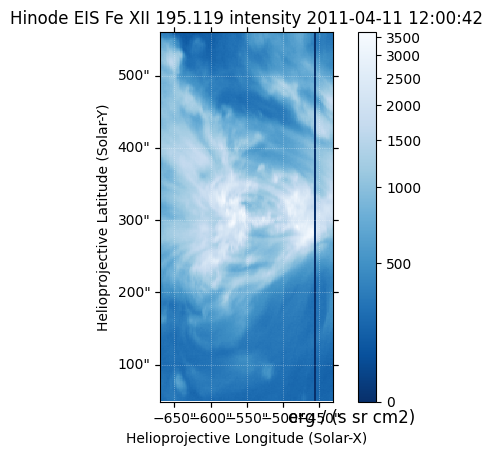

In [31]:
m.peek()

Next, we're going to take a look at a few ARs that were observed repeatedly over multiple rotations.

The goal here should be to add a column to this table that lists the accompanying EIS file for each one of these observations, if it is available. We want to match the 

In [34]:
repeated_ars_mason = astropy.table.QTable.from_pandas(pandas.read_excel('../ars_and_times_emason.xlsx'))
# Time
repeated_ars_mason['Date start'] = astropy.time.Time(repeated_ars_mason['Date1'])
repeated_ars_mason['Date end'] = astropy.time.Time(repeated_ars_mason['Date2'])
repeated_ars_mason['Date mid'] = repeated_ars_mason['Date start'] + (repeated_ars_mason['Date end'] - repeated_ars_mason['Date start'])/2
# Coordinates
blc = []
trc = []
for row_m,row in zip(repeated_ars_mason.mask, repeated_ars_mason):
    if row_m['bottom_left_x']:
        blc_Tx = row['X'] - row['W'] / 2
        blc_Ty = row['Y'] - row['H'] / 2
        trc_Tx = row['X'] + row['W'] / 2
        trc_Ty = row['Y'] + row['H'] / 2
    else:
        blc_Tx = row['bottom_left_x']
        blc_Ty = row['bottom_left_y']
        trc_Tx = row['top_right_x']
        trc_Ty = row['top_right_y']
    frame = Helioprojective(observer=get_horizons_coord('SDO', time=row['Date mid']), obstime=row['Date mid'])
    blc.append(SkyCoord(Tx=blc_Tx*u.arcsec, Ty=blc_Ty*u.arcsec, frame=frame))
    trc.append(SkyCoord(Tx=trc_Tx*u.arcsec, Ty=trc_Ty*u.arcsec, frame=frame))
repeated_ars_mason['bottom left'] = blc
repeated_ars_mason['top right'] = trc
# Clean up
repeated_ars_mason.rename_column('Unnamed: 12', 'Comment')
repeated_ars_mason.remove_columns(['Date1', 'Date2', 'Unnamed: 11',
                                   'bottom_left_x', 'top_right_x', 'bottom_left_y', 'top_right_y',
                                   'X', 'Y', 'W', 'H'])

# Adding an ID that designates which ARs are the same from one rotation to the next
repeated_ars_mason['Region ID'] = 0
for i,row in enumerate(repeated_ars_mason):
    if i > 0:
        time_delta = row['Date mid'] - repeated_ars_mason[i-1]['Date mid']
        if time_delta < (30 * u.day):
            row['Region ID'] = repeated_ars_mason[i-1]['Region ID']
        else:
            row['Region ID'] = repeated_ars_mason[i-1]['Region ID'] + 1

# Make any needed manual corrections here
repeated_ars_mason[3]['Date mid'] = repeated_ars_mason[3]['Date mid'] - 1 * u.h

INFO: Obtained JPL HORIZONS location for Solar Dynamics Observatory (spac [sunpy.coordinates.ephemeris]
INFO: Obtained JPL HORIZONS location for Solar Dynamics Observatory (spac [sunpy.coordinates.ephemeris]
INFO: Obtained JPL HORIZONS location for Solar Dynamics Observatory (spac [sunpy.coordinates.ephemeris]
INFO: Obtained JPL HORIZONS location for Solar Dynamics Observatory (spac [sunpy.coordinates.ephemeris]
INFO: Obtained JPL HORIZONS location for Solar Dynamics Observatory (spac [sunpy.coordinates.ephemeris]
INFO: Obtained JPL HORIZONS location for Solar Dynamics Observatory (spac [sunpy.coordinates.ephemeris]
INFO: Obtained JPL HORIZONS location for Solar Dynamics Observatory (spac [sunpy.coordinates.ephemeris]
INFO: Obtained JPL HORIZONS location for Solar Dynamics Observatory (spac [sunpy.coordinates.ephemeris]
INFO: Obtained JPL HORIZONS location for Solar Dynamics Observatory (spac [sunpy.coordinates.ephemeris]
INFO: Obtained JPL HORIZONS location for Solar Dynamics Observat

In [35]:
repeated_ars_mason

NOAA AR,Comment,Date start,Date end,Date mid,bottom left,top right,Region ID
int64,str80,Time,Time,Time,object,object,int64
11689,* redux coordinates done via SSW Cutout Service website box selection,2013-03-10T12:00:00.000,2013-03-11T00:00:00.000,2013-03-10T18:00:00.000,"<SkyCoord (Helioprojective: obstime=2013-03-10T18:00:00.000, rsun=695700.0 km, observer=<HeliographicStonyhurst Coordinate (obstime=2013-03-10T18:00:00.000, rsun=695700.0 km): (lon, lat, radius) in (deg, deg, AU)\n (0.0023422, -7.22685834, 0.99307775)>): (Tx, Ty) in arcsec\n (-77., -461.)>","<SkyCoord (Helioprojective: obstime=2013-03-10T18:00:00.000, rsun=695700.0 km, observer=<HeliographicStonyhurst Coordinate (obstime=2013-03-10T18:00:00.000, rsun=695700.0 km): (lon, lat, radius) in (deg, deg, AU)\n (0.0023422, -7.22685834, 0.99307775)>): (Tx, Ty) in arcsec\n (384., -38.)>",0
11711,--,2013-04-05T23:00:00.000,2013-04-06T11:00:00.000,2013-04-06T05:00:00.000,"<SkyCoord (Helioprojective: obstime=2013-04-06T05:00:00.000, rsun=695700.0 km, observer=<HeliographicStonyhurst Coordinate (obstime=2013-04-06T05:00:00.000, rsun=695700.0 km): (lon, lat, radius) in (deg, deg, AU)\n (-0.00741655, -6.23860332, 1.00100687)>): (Tx, Ty) in arcsec\n (-290., -390.)>","<SkyCoord (Helioprojective: obstime=2013-04-06T05:00:00.000, rsun=695700.0 km, observer=<HeliographicStonyhurst Coordinate (obstime=2013-04-06T05:00:00.000, rsun=695700.0 km): (lon, lat, radius) in (deg, deg, AU)\n (-0.00741655, -6.23860332, 1.00100687)>): (Tx, Ty) in arcsec\n (200., -70.)>",0
11732,--,2013-05-03T06:00:00.000,2013-05-03T18:00:00.000,2013-05-03T12:00:00.000,"<SkyCoord (Helioprojective: obstime=2013-05-03T12:00:00.000, rsun=695700.0 km, observer=<HeliographicStonyhurst Coordinate (obstime=2013-05-03T12:00:00.000, rsun=695700.0 km): (lon, lat, radius) in (deg, deg, AU)\n (0.01126162, -3.90192559, 1.00817899)>): (Tx, Ty) in arcsec\n (-280., -500.)>","<SkyCoord (Helioprojective: obstime=2013-05-03T12:00:00.000, rsun=695700.0 km, observer=<HeliographicStonyhurst Coordinate (obstime=2013-05-03T12:00:00.000, rsun=695700.0 km): (lon, lat, radius) in (deg, deg, AU)\n (0.01126162, -3.90192559, 1.00817899)>): (Tx, Ty) in arcsec\n (55., -160.)>",0
11944,--,2014-01-07T15:00:00.000,2014-01-08T03:00:00.000,2014-01-07T20:00:00.000,"<SkyCoord (Helioprojective: obstime=2014-01-07T21:00:00.000, rsun=695700.0 km, observer=<HeliographicStonyhurst Coordinate (obstime=2014-01-07T21:00:00.000, rsun=695700.0 km): (lon, lat, radius) in (deg, deg, AU)\n (-0.00922921, -3.77897502, 0.98316623)>): (Tx, Ty) in arcsec\n (-300., -240.)>","<SkyCoord (Helioprojective: obstime=2014-01-07T21:00:00.000, rsun=695700.0 km, observer=<HeliographicStonyhurst Coordinate (obstime=2014-01-07T21:00:00.000, rsun=695700.0 km): (lon, lat, radius) in (deg, deg, AU)\n (-0.00922921, -3.77897502, 0.98316623)>): (Tx, Ty) in arcsec\n (125., 10.)>",1
11967,--,2014-02-03T00:00:00.000,2014-02-03T12:00:00.000,2014-02-03T06:00:00.000,"<SkyCoord (Helioprojective: obstime=2014-02-03T06:00:00.000, rsun=695700.0 km, observer=<HeliographicStonyhurst Coordinate (obstime=2014-02-03T06:00:00.000, rsun=695700.0 km): (lon, lat, radius) in (deg, deg, AU)\n (-0.001059, -6.18035844, 0.98589338)>): (Tx, Ty) in arcsec\n (-325., -285.)>","<SkyCoord (Helioprojective: obstime=2014-02-03T06:00:00.000, rsun=695700.0 km, observer=<HeliographicStonyhurst Coordinate (obstime=2014-02-03T06:00:00.000, rsun=695700.0 km): (lon, lat, radius) in (deg, deg, AU)\n (-0.001059, -6.18035844, 0.98589338)>): (Tx, Ty) in arcsec\n (200., 5.)>",1
11990,* redux coordinates done via SSW Cutout Service website box selection,2014-03-02T18:30:00.000,2014-03-03T00:30:00.000,2014-03-02T21:30:00.000,"<SkyCoord (Helioprojective: obstime=2014-03-02T21:30:00.000, rsun=695700.0 km, observer=<HeliographicStonyhurst Coordinate (obstime=2014-03-02T21:30:00.000, rsun=695700.0 km): (lon, lat, radius) in (deg, deg, AU)\n (-0.0069234, -7.24283039, 0.99101118)>): (Tx, Ty) in arcsec\n (-154., -307.)>","<SkyCoord (Hel

I'm going to download some AIA maps for one of the regions to double check I'm choosing the right ARS

In [36]:
def extract_fov(header_filename):
    with h5py.File(header_filename) as hf:
        offset = u.Quantity([hf['pointing/offset_x'][0], hf['pointing/offset_y'][0]], 'arcsec')
        center_original = u.Quantity([hf['pointing/xcen'][0], hf['pointing/ycen'][0]], 'arcsec')
        center = center_original + offset
        scale = u.Quantity([hf['pointing/x_scale'][0], hf['pointing/y_scale'][0]], 'arcsec/pixel')
        center[1] = center[1] - np.mean(hf['ccd_offsets/win00']) * u.pix * scale[1]
        fov = u.Quantity([hf['pointing/fovx'][0], hf['pointing/fovy'][0]], 'pixel') * scale
        date = astropy.time.Time(hf['pointing/ref_time'][0].decode('utf-8'))
        frame = Helioprojective(observer=get_earth(date))
        # NOTE: Sometimes the pointing is way off and it throws an exception when creating a coord
        try:
            center_coord = SkyCoord(Tx=center[0], Ty=center[1], frame=frame)
        except ValueError:
            print(f'Bad pointing for {header_filename}')
            return None, None
        bottom_left_coord = SkyCoord(Tx=center[0]-fov[0]/2, Ty=center[1]-fov[1]/2, frame=frame)
    return bottom_left_coord, fov

Files Downloaded:   0%|          | 0/3 [00:00<?, ?file/s]

Files Downloaded:   0%|          | 0/3 [00:00<?, ?file/s]

Files Downloaded:   0%|          | 0/3 [00:00<?, ?file/s]

Files Downloaded:   0%|          | 0/3 [00:00<?, ?file/s]

Files Downloaded:   0%|          | 0/3 [00:00<?, ?file/s]

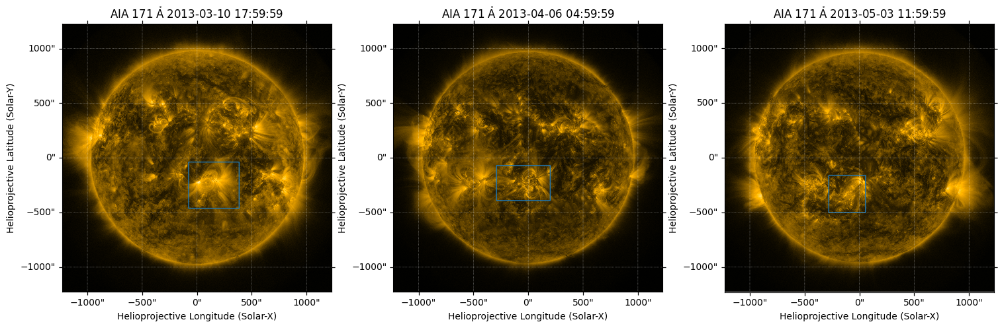

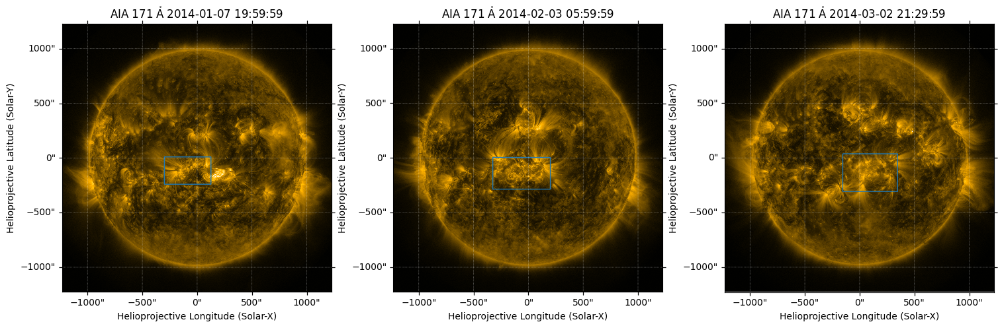

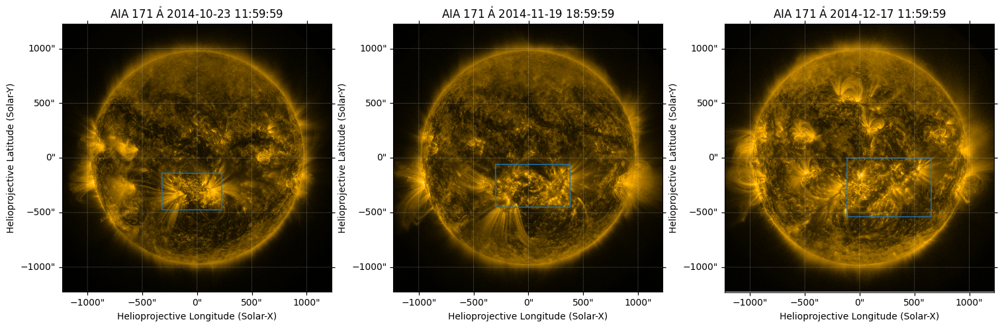

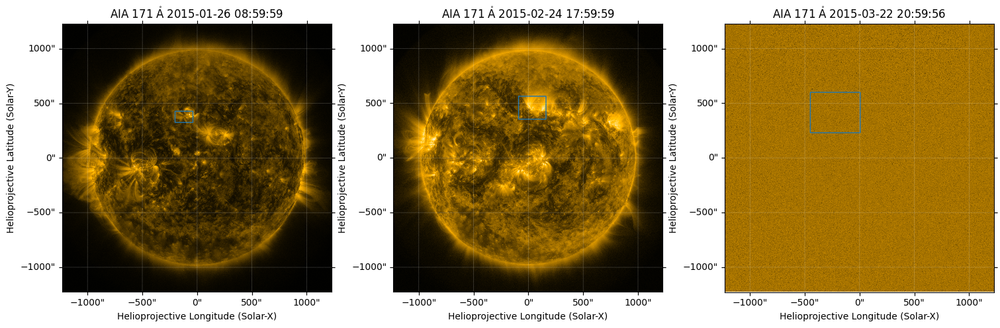

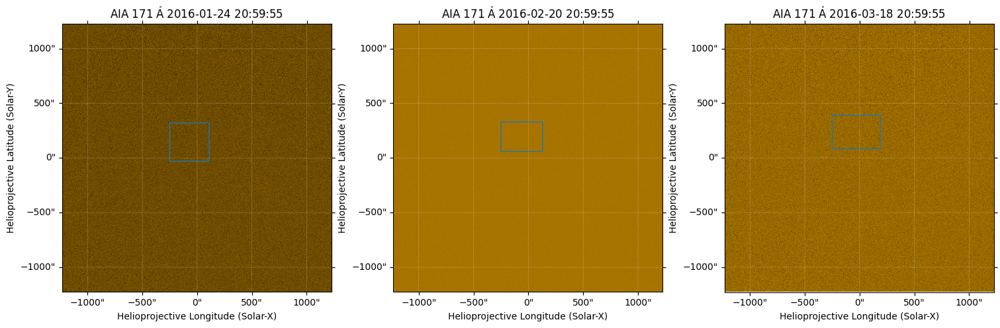

In [40]:
for table_region in repeated_ars_mason.group_by('Region ID').groups:
    # Get AIA images
    q = Fido.search(
        a.AttrOr([a.Time(r['Date start'], end=r['Date end'], near=r['Date mid']) for r in table_region]),
        a.Instrument.aia,
        a.Wavelength(171*u.AA),
    )
    files_aia = Fido.fetch(q, path='../data/AIA/level_1/{file}')
    maps_aia = sunpy.map.Map(sorted(files_aia))
   ## Get EIS headers
   #q = Fido.search(
   #    a.AttrOr([a.Time(r['Date start'], end=r['Date end'], near=r['Date mid']) for r in table_region]),
   #    a.Instrument('EIS'),
   #    a.Physobs('Intensity'),
   #    a.Source('Hinode'),
   #    a.Provider('NRL'),
   #    a.Level('1'),
   #    a.eispac.FileType('HDF5 header'),
   #)
   #eis_headers = Fido.fetch(q, path='../data/EIS/level_1/{file}')

    # Plot EIS FOV on top of AIA context images
    fig = plt.figure(figsize=(15,5), layout='constrained')
    for i,(m,r) in enumerate(zip(maps_aia,table_region)):
        ax = fig.add_subplot(1, len(maps_aia), i+1, projection=m)
        m.plot(axes=ax)
        #for filename in eis_headers:
        #    if ''.join(m.date.iso.split()[0].split('-')) in filename:
        #        bl, fov = extract_fov(filename)
        #        if bl is None:
        #            continue
        #        m.draw_quadrangle(bl, width=fov[0], height=fov[1],axes=ax)
        m.draw_quadrangle(r['bottom left'], top_right=r['top right'], edgecolor='C0', axes=ax)

In [313]:
from sunpy.coordinates import propagate_with_solar_surface

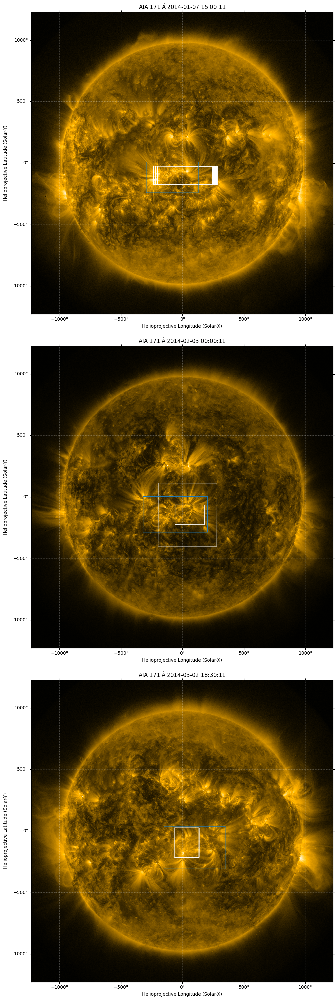

In [319]:
#for table_region in [repeated_ars_mason.group_by('Region ID').groups[1]]:
# Get AIA images
#q = Fido.search(
#    a.AttrOr([a.Time(r['Date start'], end=r['Date end'], near=r['Date start']) for r in table_region]),
#    a.Instrument.aia,
#    a.Wavelength(171*u.AA),
#)
#files_aia = Fido.fetch(q, path='../data/AIA/level_1/{file}')
#maps_aia = sunpy.map.Map(sorted(files_aia))
# Get EIS headers
#q = Fido.search(
#    a.AttrOr([a.Time(r['Date start'], end=r['Date end'], near=r['Date mid']) for r in table_region]),
#    a.Instrument('EIS'),
#    a.Physobs('Intensity'),
#    a.Source('Hinode'),
#    a.Provider('NRL'),
#    a.Level('1'),
#    a.eispac.FileType('HDF5 header'),
#)
#eis_headers = Fido.fetch(q, path='../data/EIS/level_1/{file}')

# Plot EIS FOV on top of AIA context images
fig = plt.figure(figsize=(10,30), layout='constrained')
for i,(m,r) in enumerate(zip(maps_aia,table_region)):
    ax = fig.add_subplot(len(maps_aia), 1, i+1, projection=m)
    m.plot(axes=ax)
    for filename in eis_headers:
        if ''.join(m.date.iso.split()[0].split('-')) in filename:
            bl, fov = extract_fov(filename)
            if bl is None:
                continue
            m.draw_quadrangle(bl, width=fov[0], height=fov[1],axes=ax)
    m.draw_quadrangle(r['bottom left'], top_right=r['top right'], edgecolor='C0', axes=ax)

In [332]:
region_1_table = repeated_ars_mason[repeated_ars_mason['Region ID']==1]
eis_header_files = []
for r in region_1_table:
    date_str = ''.join(r['Date mid'].iso.split()[0].split('-'))
    header_files = sorted(pathlib.Path('../data/EIS/level_1/').glob(f'eis_{date_str}_*.head.h5'))
    coords = [extract_fov(f)[0] for f in header_files]
    dates = astropy.time.Time([c.obstime for c in coords])
    i_nearest = np.argmin(np.fabs((dates - r['Date mid']).to('s')))
    eis_header_files.append(header_files[i_nearest])
region_1_table['EIS File'] = eis_header_files

In [333]:
region_1_table

NOAA AR,Comment,Date start,Date end,Date mid,bottom left,top right,Region ID,EIS File
int64,str80,Time,Time,Time,object,object,int64,object
11944,--,2014-01-07T15:00:00.000,2014-01-08T03:00:00.000,2014-01-07T20:00:00.000,"<SkyCoord (Helioprojective: obstime=2014-01-07T21:00:00.000, rsun=695700.0 km, observer=<HeliographicStonyhurst Coordinate (obstime=2014-01-07T21:00:00.000, rsun=695700.0 km): (lon, lat, radius) in (deg, deg, AU)\n (-0.00922921, -3.77897502, 0.98316623)>): (Tx, Ty) in arcsec\n (-300., -240.)>","<SkyCoord (Helioprojective: obstime=2014-01-07T21:00:00.000, rsun=695700.0 km, observer=<HeliographicStonyhurst Coordinate (obstime=2014-01-07T21:00:00.000, rsun=695700.0 km): (lon, lat, radius) in (deg, deg, AU)\n (-0.00922921, -3.77897502, 0.98316623)>): (Tx, Ty) in arcsec\n (125., 10.)>",1,../data/EIS/level_1/eis_20140107_195857.head.h5
11967,--,2014-02-03T00:00:00.000,2014-02-03T12:00:00.000,2014-02-03T06:00:00.000,"<SkyCoord (Helioprojective: obstime=2014-02-03T06:00:00.000, rsun=695700.0 km, observer=<HeliographicStonyhurst Coordinate (obstime=2014-02-03T06:00:00.000, rsun=695700.0 km): (lon, lat, radius) in (deg, deg, AU)\n (-0.001059, -6.18035844, 0.98589338)>): (Tx, Ty) in arcsec\n (-325., -285.)>","<SkyCoord (Helioprojective: obstime=2014-02-03T06:00:00.000, rsun=695700.0 km, observer=<HeliographicStonyhurst Coordinate (obstime=2014-02-03T06:00:00.000, rsun=695700.0 km): (lon, lat, radius) in (deg, deg, AU)\n (-0.001059, -6.18035844, 0.98589338)>): (Tx, Ty) in arcsec\n (200., 5.)>",1,../data/EIS/level_1/eis_20140203_093134.head.h5
11990,* redux coordinates done via SSW Cutout Service website box selection,2014-03-02T18:30:00.000,2014-03-03T00:30:00.000,2014-03-02T21:30:00.000,"<SkyCoord (Helioprojective: obstime=2014-03-02T21:30:00.000, rsun=695700.0 km, observer=<HeliographicStonyhurst Coordinate (obstime=2014-03-02T21:30:00.000, rsun=695700.0 km): (lon, lat, radius) in (deg, deg, AU)\n (-0.0069234, -7.24283039, 0.99101118)>): (Tx, Ty) in arcsec\n (-154., -307.)>","<SkyCoord (Helioprojective: obstime=2014-03-02T21:30:00.000, rsun=695700.0 km, observer=<HeliographicStonyhurst Coordinate (obstime=2014-03-02T21:30:00.000, rsun=695700.0 km): (lon, lat, radius) in (deg, deg, AU)\n (-0.0069234, -7.24283039, 0.99101118)>): (Tx, Ty) in arcsec\n (346., 38.)>",1,../data/EIS/level_1/eis_20140302_230733.head.h5


In [338]:
q = Fido.search(
    a.AttrOr([a.Time(r['Date start'], end=r['Date end'], near=r['Date mid']) for r in region_1_table]),
    a.Instrument.aia,
    a.Wavelength(171*u.AA),
)
files_aia = Fido.fetch(q, path='../data/AIA/level_1/{file}')
maps_aia = sunpy.map.Map(sorted(files_aia))

Files Downloaded:   0%|          | 0/3 [00:00<?, ?file/s]

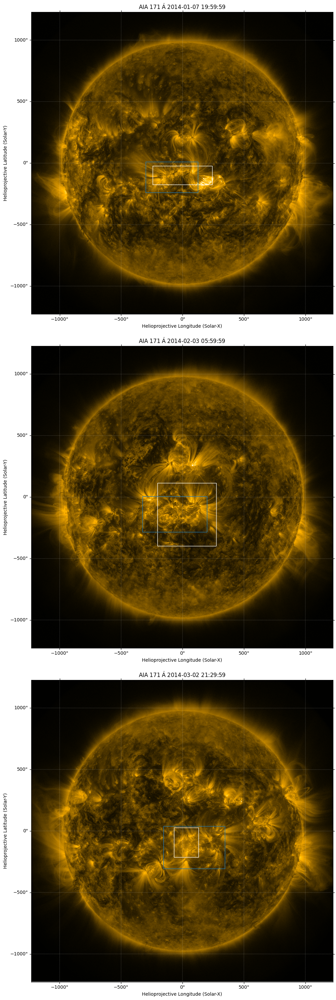

In [339]:
fig = plt.figure(figsize=(10,30), layout='constrained')
for i,(r,m) in enumerate(zip(region_1_table,maps_aia)):
    ax = fig.add_subplot(len(region_1_table), 1, i+1, projection=m)
    m.plot(axes=ax)
    bl, fov = extract_fov(r['EIS File'])
    with propagate_with_solar_surface():
        m.draw_quadrangle(bl, width=fov[0], height=fov[1],axes=ax)
        m.draw_quadrangle(r['bottom left'], top_right=r['top right'], edgecolor='C0', axes=ax)

Now download only the raster data that we actually want

In [345]:
q = Fido.search(
    a.AttrOr([a.Time(r['Date start'], end=r['Date end'], near=r['Date mid']) for r in region_1_table]),
    a.Instrument('EIS'),
    a.Physobs('Intensity'),
    a.Source('Hinode'),
    a.Provider('NRL'),
    a.Level('1'),
    a.eispac.FileType('HDF5 data'),
)

In [353]:
q_selected = []
for tab,row in zip(q,region_1_table):
    i_nearest = np.argmin(np.fabs((tab['Start Time'] - row['Date mid']).to('s')))
    q_selected.append(tab[i_nearest])
eis_files = Fido.fetch(*q_selected, path='../data/EIS/level_1/')

Files Downloaded:   0%|          | 0/3 [00:00<?, ?file/s]

eis_20140107_195857.data.h5:   0%|          | 0.00/10.8M [00:00<?, ?B/s]

eis_20140203_093134.data.h5:   0%|          | 0.00/197M [00:00<?, ?B/s]

eis_20140302_230733.data.h5:   0%|          | 0.00/33.0M [00:00<?, ?B/s]

Fit all of the selected rasters

In [354]:
for row in selected_line_table:
    template = eispac.read_template(eispac.data.get_fit_template_filepath(row['Template']))
    print(template)
    for _row in region_1_table:
        cube = eispac.read_cube(_row['EIS File'], window=template.central_wave)
        fit_res = eispac.fit_spectra(cube, template, ncpu='max')
        _ = eispac.export_fits(fit_res, save_dir='../data/EIS/level_3')

--- EISFitTemplate SUMMARY ---
filename_temp: /Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/data/templates/fe_11_180_401.1c.template.h5
n_gauss: 1
n_poly: 1
line_ids: ['Fe XI 180.401']
wmin, wmax: 180.2010040283203, 180.5500030517578

--- PARAMETER CONSTRAINTS ---
   *            Value   Fixed     Limited              Limits                Tied
  p[0]     48352.2153       0     1     0       0.0000       0.0000                   
  p[1]       180.4042       0     1     1     180.3641     180.4444                   
  p[2]         0.0295       0     1     1       0.0191       0.0510                   
  p[3]       848.0303       0     0     0       0.0000       0.0000                   
Data file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20140107_195857.data.h5
Header file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20140107_195857.head.h5
Data 

Error: Wavelength not found! The input data file does not contain a window that observes 180.37550354003906 Angstroms
Error: missing or invalid data. Please input a filepath, EISCube, or complete set of intensity, wavelength, and error arrays.
Error: Please input a valid EISFitResult object.


 + working on exposure 105

Finished computing fits!
   runtime : 0:00:12.983340
   48970 spectra fit without issues
   12470 spectra have < 7 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_3
   Filenames: eis_20140203_093134.fe_11_180_401.1c-0.int.fits
              eis_20140203_093134.fe_11_180_401.1c-0.vel.fits
              eis_20140203_093134.fe_11_180_401.1c-0.wid.fits
Data file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20140302_230733.data.h5
Header file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20140302_230733.head.h5
--- EISFitTemplate SUMMARY ---
filename_temp: /Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/data/templates/fe_10_184_536.1c.template.h5
n_gauss: 1
n_poly: 1
line_ids: ['Fe X 184.536']
wmin, wmax: 184.49000549

/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent
Error: Wavelength not found! The input data file does not contain a window that observes 180.37550354003906 Angstroms
Error: missing or invalid data. Please input a filepath, EISCube, or complete set of intensity, wavelength, and error arrays.
Error: Please input a valid EISFitResult object.


 + working on exposure 048

Finished computing fits!
   runtime : 0:00:05.519249
   8208 spectra fit without issues
   0 spectra have < 7 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_3
   Filenames: eis_20140107_195857.fe_10_184_536.1c-0.int.fits
              eis_20140107_195857.fe_10_184_536.1c-0.vel.fits
              eis_20140107_195857.fe_10_184_536.1c-0.wid.fits
Data file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20140203_093134.data.h5
Header file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20140203_093134.head.h5
Found a wavelength 184.60 [Angstroms] in window 2
INFO: uncertainty should have attribute uncertainty_type. [astropy.nddata.nddata]
 + computing fits for 120 exposures, each with 512 spectra
 + running mpfit on 10 cores (of 10)
 + working on exposure 

/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent


 + working on exposure 048

Finished computing fits!
   runtime : 0:00:04.723282
   11950 spectra fit without issues
   50 spectra have < 7 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_3
   Filenames: eis_20140302_230733.fe_10_184_536.1c-0.int.fits
              eis_20140302_230733.fe_10_184_536.1c-0.vel.fits
              eis_20140302_230733.fe_10_184_536.1c-0.wid.fits
--- EISFitTemplate SUMMARY ---
filename_temp: /Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/data/templates/fe_11_188_216.2c.template.h5
n_gauss: 2
n_poly: 1
line_ids: ['Fe XI 188.216' 'Fe XI 188.299']
wmin, wmax: 188.01600646972656, 188.38999938964844

--- PARAMETER CONSTRAINTS ---
   *            Value   Fixed     Limited              Limits                Tied
  p[0]     30482.7473       0     1     0       0.0000       0.0000                   
  p[1]       188.2168

/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent
Error: Wavelength not found! The input data file does not contain a window that observes 188.2030029296875 Angstroms
Error: missing or invalid data. Please input a filepath, EISCube, or complete set of intensity, wavelength, and error arrays.
Error: Please input a valid EISFitResult object.


 + computing fits for 120 exposures, each with 512 spectra
 + running mpfit on 10 cores (of 10)
 + working on exposure 108

Finished computing fits!
   runtime : 0:00:15.790339
   45468 spectra fit without issues
   15972 spectra have < 7 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_3
   Filenames: eis_20140203_093134.fe_11_188_216.2c-0.int.fits
              eis_20140203_093134.fe_11_188_216.2c-0.vel.fits
              eis_20140203_093134.fe_11_188_216.2c-0.wid.fits
              eis_20140203_093134.fe_11_188_299.2c-1.int.fits
              eis_20140203_093134.fe_11_188_299.2c-1.vel.fits
              eis_20140203_093134.fe_11_188_299.2c-1.wid.fits
Data file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20140302_230733.data.h5
Header file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/

/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent


 + working on exposure 050

Finished computing fits!
   runtime : 0:00:06.315220
   12000 spectra fit without issues
   0 spectra have < 7 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_3
   Filenames: eis_20140302_230733.fe_11_188_216.2c-0.int.fits
              eis_20140302_230733.fe_11_188_216.2c-0.vel.fits
              eis_20140302_230733.fe_11_188_216.2c-0.wid.fits
              eis_20140302_230733.fe_11_188_299.2c-1.int.fits
              eis_20140302_230733.fe_11_188_299.2c-1.vel.fits
              eis_20140302_230733.fe_11_188_299.2c-1.wid.fits
--- EISFitTemplate SUMMARY ---
filename_temp: /Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/data/templates/fe_09_188_497.3c.template.h5
n_gauss: 3
n_poly: 1
line_ids: ['Fe IX 188.497' 'S XI 188.675' 'Ar XI 188.806']
wmin, wmax: 188.39999389648438, 188.9499969482422

--- PARAMETER CONSTRA

Error: Wavelength not found! The input data file does not contain a window that observes 188.67499542236328 Angstroms
Error: missing or invalid data. Please input a filepath, EISCube, or complete set of intensity, wavelength, and error arrays.
Error: Please input a valid EISFitResult object.
/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:164: RuntimeWarning: invalid value encountered in scalar divide
  fit_dict['chi2'][ii,jj] = out.fnorm/out.dof
/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:164: RuntimeWarning: divide by zero encountered in scalar divide
  fit_dict['chi2'][ii,jj] = out.fnorm/out.dof
/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:164: RuntimeWarning: divide by zero encountered in scalar divide
  fit_dict['chi2'][ii,jj] = out.fnorm/out.dof
/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/

 + working on exposure 105

Finished computing fits!
   runtime : 0:01:04.763016
   45273 spectra fit without issues
   16167 spectra have < 10 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_3
   Filenames: eis_20140203_093134.fe_09_188_497.3c-0.int.fits
              eis_20140203_093134.fe_09_188_497.3c-0.vel.fits
              eis_20140203_093134.fe_09_188_497.3c-0.wid.fits
              eis_20140203_093134.s__11_188_675.3c-1.int.fits
              eis_20140203_093134.s__11_188_675.3c-1.vel.fits
              eis_20140203_093134.s__11_188_675.3c-1.wid.fits
              eis_20140203_093134.ar_11_188_806.3c-2.int.fits
              eis_20140203_093134.ar_11_188_806.3c-2.vel.fits
              eis_20140203_093134.ar_11_188_806.3c-2.wid.fits
Data file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20140302_230733.data.h5
Heade

/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent


INFO: uncertainty should have attribute uncertainty_type. [astropy.nddata.nddata]
 + computing fits for 50 exposures, each with 240 spectra
 + running mpfit on 10 cores (of 10)
 + working on exposure 044

Finished computing fits!
   runtime : 0:00:20.256959
   12000 spectra fit without issues
   0 spectra have < 10 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_3
   Filenames: eis_20140302_230733.fe_09_188_497.3c-0.int.fits
              eis_20140302_230733.fe_09_188_497.3c-0.vel.fits
              eis_20140302_230733.fe_09_188_497.3c-0.wid.fits
              eis_20140302_230733.s__11_188_675.3c-1.int.fits
              eis_20140302_230733.s__11_188_675.3c-1.vel.fits
              eis_20140302_230733.s__11_188_675.3c-1.wid.fits
              eis_20140302_230733.ar_11_188_806.3c-2.int.fits
              eis_20140302_230733.ar_11_188_806.3c-2.vel.fits
              eis_201403

/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent


 + working on exposure 050

Finished computing fits!
   runtime : 0:00:04.470508
   12000 spectra fit without issues
   0 spectra have < 7 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_3
   Filenames: eis_20140302_230733.fe_12_192_394.1c-0.int.fits
              eis_20140302_230733.fe_12_192_394.1c-0.vel.fits
              eis_20140302_230733.fe_12_192_394.1c-0.wid.fits
--- EISFitTemplate SUMMARY ---
filename_temp: /Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/data/templates/ca_17_192_858.1c.template.h5
n_gauss: 1
n_poly: 1
line_ids: ['Ca XVII 192.858']
wmin, wmax: 192.6999969482422, 193.1999969482422

--- PARAMETER CONSTRAINTS ---
   *            Value   Fixed     Limited              Limits                Tied
  p[0]     37958.2385       0     1     0       0.0000       0.0000                   
  p[1]       192.8458       0     1   

/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent


 + working on exposure 048

Finished computing fits!
   runtime : 0:00:07.150868
   12000 spectra fit without issues
   0 spectra have < 7 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_3
   Filenames: eis_20140302_230733.ca_17_192_858.1c-0.int.fits
              eis_20140302_230733.ca_17_192_858.1c-0.vel.fits
              eis_20140302_230733.ca_17_192_858.1c-0.wid.fits
--- EISFitTemplate SUMMARY ---
filename_temp: /Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/data/templates/ca_14_193_874.6c.template.h5
n_gauss: 6
n_poly: 1
line_ids: ['Fe X 193.715' 'Ca XIV 193.874' 'Ni XVI 194.046' 'Ar XI 194.104'
 'Mn X 194.327' 'Ar XIV 194.396']
wmin, wmax: 193.60000610351562, 194.60000610351562

--- PARAMETER CONSTRAINTS ---
   *            Value   Fixed     Limited              Limits                Tied
  p[0]      3058.9379       0     1     0  

Error: Wavelength not found! The input data file does not contain a window that observes 194.10000610351562 Angstroms
Error: missing or invalid data. Please input a filepath, EISCube, or complete set of intensity, wavelength, and error arrays.
Error: Please input a valid EISFitResult object.


 + working on exposure 105

Finished computing fits!
   runtime : 0:03:02.373328
   45954 spectra fit without issues
   15486 spectra have < 19 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_3
   Filenames: eis_20140203_093134.fe_10_193_715.6c-0.int.fits
              eis_20140203_093134.fe_10_193_715.6c-0.vel.fits
              eis_20140203_093134.fe_10_193_715.6c-0.wid.fits
              eis_20140203_093134.ca_14_193_874.6c-1.int.fits
              eis_20140203_093134.ca_14_193_874.6c-1.vel.fits
              eis_20140203_093134.ca_14_193_874.6c-1.wid.fits
              eis_20140203_093134.ni_16_194_046.6c-2.int.fits
              eis_20140203_093134.ni_16_194_046.6c-2.vel.fits
              eis_20140203_093134.ni_16_194_046.6c-2.wid.fits
              eis_20140203_093134.ar_11_194_104.6c-3.int.fits
              eis_20140203_093134.ar_11_194_104.6c-3.vel.fits
           

/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent


Data file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20140302_230733.data.h5
Header file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20140302_230733.head.h5
--- EISFitTemplate SUMMARY ---
filename_temp: /Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/data/templates/fe_12_195_119.2c.template.h5
n_gauss: 2
n_poly: 1
line_ids: ['Fe XII 195.119' 'Fe XII 195.179']
wmin, wmax: 194.9600067138672, 195.25

--- PARAMETER CONSTRAINTS ---
   *            Value   Fixed     Limited              Limits                Tied
  p[0]     57514.6647       0     1     0       0.0000       0.0000                   
  p[1]       195.1179       0     1     1     195.0778     195.1581                   
  p[2]         0.0289       0     1     1       0.0191       0.0510                   
  p[3]      8013.4013       0     1     0       0.0000       0.0000                  

Error: Wavelength not found! The input data file does not contain a window that observes 194.10000610351562 Angstroms
Error: missing or invalid data. Please input a filepath, EISCube, or complete set of intensity, wavelength, and error arrays.
Error: Please input a valid EISFitResult object.


 + working on exposure 054

Finished computing fits!
   runtime : 0:00:06.488825
   8208 spectra fit without issues
   0 spectra have < 7 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_3
   Filenames: eis_20140107_195857.fe_12_195_119.2c-0.int.fits
              eis_20140107_195857.fe_12_195_119.2c-0.vel.fits
              eis_20140107_195857.fe_12_195_119.2c-0.wid.fits
              eis_20140107_195857.fe_12_195_179.2c-1.int.fits
              eis_20140107_195857.fe_12_195_179.2c-1.vel.fits
              eis_20140107_195857.fe_12_195_179.2c-1.wid.fits
Data file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20140203_093134.data.h5
Header file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20140203_093134.head.h5
Found a wavelength 195.11 [Angstroms] in window 8
INFO: uncertain

/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent


 + working on exposure 050

Finished computing fits!
   runtime : 0:00:06.608689
   12000 spectra fit without issues
   0 spectra have < 7 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_3
   Filenames: eis_20140302_230733.fe_12_195_119.2c-0.int.fits
              eis_20140302_230733.fe_12_195_119.2c-0.vel.fits
              eis_20140302_230733.fe_12_195_119.2c-0.wid.fits
              eis_20140302_230733.fe_12_195_179.2c-1.int.fits
              eis_20140302_230733.fe_12_195_179.2c-1.vel.fits
              eis_20140302_230733.fe_12_195_179.2c-1.wid.fits
--- EISFitTemplate SUMMARY ---
filename_temp: /Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/data/templates/fe_09_197_862.1c.template.h5
n_gauss: 1
n_poly: 1
line_ids: ['Fe IX 197.862']
wmin, wmax: 197.67999267578125, 197.9499969482422

--- PARAMETER CONSTRAINTS ---
   *            Value 

Error: Wavelength not found! The input data file does not contain a window that observes 197.81499481201172 Angstroms
Error: missing or invalid data. Please input a filepath, EISCube, or complete set of intensity, wavelength, and error arrays.
Error: Please input a valid EISFitResult object.


 + working on exposure 108

Finished computing fits!
   runtime : 0:00:14.530839
   45136 spectra fit without issues
   16304 spectra have < 7 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_3
   Filenames: eis_20140203_093134.fe_09_197_862.1c-0.int.fits
              eis_20140203_093134.fe_09_197_862.1c-0.vel.fits
              eis_20140203_093134.fe_09_197_862.1c-0.wid.fits
Data file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20140302_230733.data.h5
Header file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20140302_230733.head.h5
--- EISFitTemplate SUMMARY ---
filename_temp: /Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/data/templates/ca_15_200_972.2c.template.h5
n_gauss: 2
n_poly: 1
line_ids: ['Ca XV 200.972' 'Fe XIII 201.121']
wmin,

/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent
Error: Wavelength not found! The input data file does not contain a window that observes 197.81499481201172 Angstroms
Error: missing or invalid data. Please input a filepath, EISCube, or complete set of intensity, wavelength, and error arrays.
Error: Please input a valid EISFitResult object.
Error: Wavelength not found! The input data file does not contain a window that observes 201.0449981689453 Angstroms
Error: missing or invalid data. Please input a filepath, EISCube, or complete set of intensity, wavelength, and error arrays.
Error: Please input a valid EISFitResult object.
/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:164: RuntimeWarning: divide by zero encountered in scalar divide
  fit_dict['chi2'][ii,jj] = out.fnorm/out.dof
/Users/wt

 + working on exposure 105

Finished computing fits!
   runtime : 0:00:25.871484
   46077 spectra fit without issues
   15363 spectra have < 7 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_3
   Filenames: eis_20140203_093134.ca_15_200_972.2c-0.int.fits
              eis_20140203_093134.ca_15_200_972.2c-0.vel.fits
              eis_20140203_093134.ca_15_200_972.2c-0.wid.fits
              eis_20140203_093134.fe_13_201_121.2c-1.int.fits
              eis_20140203_093134.fe_13_201_121.2c-1.vel.fits
              eis_20140203_093134.fe_13_201_121.2c-1.wid.fits
Data file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20140302_230733.data.h5
Header file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20140302_230733.head.h5
--- EISFitTemplate SUMMARY ---
filename_temp: /Users/wtbarne

/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent
Error: Wavelength not found! The input data file does not contain a window that observes 201.0449981689453 Angstroms
Error: missing or invalid data. Please input a filepath, EISCube, or complete set of intensity, wavelength, and error arrays.
Error: Please input a valid EISFitResult object.
Error: Wavelength not found! The input data file does not contain a window that observes 202.0719985961914 Angstroms
Error: missing or invalid data. Please input a filepath, EISCube, or complete set of intensity, wavelength, and error arrays.
Error: Please input a valid EISFitResult object.


INFO: uncertainty should have attribute uncertainty_type. [astropy.nddata.nddata]
 + computing fits for 120 exposures, each with 512 spectra
 + running mpfit on 10 cores (of 10)
 + working on exposure 102

Finished computing fits!
   runtime : 0:00:09.061200
   46045 spectra fit without issues
   15395 spectra have < 7 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_3
   Filenames: eis_20140203_093134.fe_13_202_044.1c-0.int.fits
              eis_20140203_093134.fe_13_202_044.1c-0.vel.fits
              eis_20140203_093134.fe_13_202_044.1c-0.wid.fits
Data file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20140302_230733.data.h5
Header file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20140302_230733.head.h5
Found a wavelength 202.07 [Angstroms] in window 6
INFO: uncertainty 

/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent


 + working on exposure 050

Finished computing fits!
   runtime : 0:00:04.690124
   12000 spectra fit without issues
   0 spectra have < 7 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_3
   Filenames: eis_20140302_230733.fe_13_202_044.1c-0.int.fits
              eis_20140302_230733.fe_13_202_044.1c-0.vel.fits
              eis_20140302_230733.fe_13_202_044.1c-0.wid.fits
--- EISFitTemplate SUMMARY ---
filename_temp: /Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/data/templates/fe_13_203_826.2c.template.h5
n_gauss: 2
n_poly: 1
line_ids: ['Fe XII 203.720' 'Fe XIII 203.826']
wmin, wmax: 203.5399932861328, 204.02999877929688

--- PARAMETER CONSTRAINTS ---
   *            Value   Fixed     Limited              Limits                Tied
  p[0]     16771.5058       0     1     0       0.0000       0.0000                   
  p[1]       203.730

Error: Wavelength not found! The input data file does not contain a window that observes 203.78499603271484 Angstroms
Error: missing or invalid data. Please input a filepath, EISCube, or complete set of intensity, wavelength, and error arrays.
Error: Please input a valid EISFitResult object.


 + working on exposure 108

Finished computing fits!
   runtime : 0:00:19.459737
   46080 spectra fit without issues
   15360 spectra have < 7 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_3
   Filenames: eis_20140203_093134.fe_12_203_720.2c-0.int.fits
              eis_20140203_093134.fe_12_203_720.2c-0.vel.fits
              eis_20140203_093134.fe_12_203_720.2c-0.wid.fits
              eis_20140203_093134.fe_13_203_826.2c-1.int.fits
              eis_20140203_093134.fe_13_203_826.2c-1.vel.fits
              eis_20140203_093134.fe_13_203_826.2c-1.wid.fits
Data file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20140302_230733.data.h5
Header file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20140302_230733.head.h5
Found a wavelength 203.78 [Angstroms] in window 7
INFO: unce

/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent


 + working on exposure 048

Finished computing fits!
   runtime : 0:00:06.376102
   12000 spectra fit without issues
   0 spectra have < 7 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_3
   Filenames: eis_20140302_230733.fe_12_203_720.2c-0.int.fits
              eis_20140302_230733.fe_12_203_720.2c-0.vel.fits
              eis_20140302_230733.fe_12_203_720.2c-0.wid.fits
              eis_20140302_230733.fe_13_203_826.2c-1.int.fits
              eis_20140302_230733.fe_13_203_826.2c-1.vel.fits
              eis_20140302_230733.fe_13_203_826.2c-1.wid.fits
--- EISFitTemplate SUMMARY ---
filename_temp: /Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/data/templates/ca_16_208_604.2c.template.h5
n_gauss: 2
n_poly: 1
line_ids: ['Ca XVI 208.604' 'Fe XIII 208.679']
wmin, wmax: 208.4040069580078, 208.94000244140625

--- PARAMETER CONSTRAINTS ---
   

Error: Wavelength not found! The input data file does not contain a window that observes 208.67200469970703 Angstroms
Error: missing or invalid data. Please input a filepath, EISCube, or complete set of intensity, wavelength, and error arrays.
Error: Please input a valid EISFitResult object.


 + working on exposure 105

Finished computing fits!
   runtime : 0:00:44.509435
   45854 spectra fit without issues
   15586 spectra have < 7 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_3
   Filenames: eis_20140203_093134.ca_16_208_604.2c-0.int.fits
              eis_20140203_093134.ca_16_208_604.2c-0.vel.fits
              eis_20140203_093134.ca_16_208_604.2c-0.wid.fits
              eis_20140203_093134.fe_13_208_679.2c-1.int.fits
              eis_20140203_093134.fe_13_208_679.2c-1.vel.fits
              eis_20140203_093134.fe_13_208_679.2c-1.wid.fits
Data file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20140302_230733.data.h5
Header file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20140302_230733.head.h5
--- EISFitTemplate SUMMARY ---
filename_temp: /Users/wtbarne

/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent
Error: Wavelength not found! The input data file does not contain a window that observes 208.67200469970703 Angstroms
Error: missing or invalid data. Please input a filepath, EISCube, or complete set of intensity, wavelength, and error arrays.
Error: Please input a valid EISFitResult object.
Error: Wavelength not found! The input data file does not contain a window that observes 256.6579895019531 Angstroms
Error: missing or invalid data. Please input a filepath, EISCube, or complete set of intensity, wavelength, and error arrays.
Error: Please input a valid EISFitResult object.


INFO: uncertainty should have attribute uncertainty_type. [astropy.nddata.nddata]
 + computing fits for 120 exposures, each with 512 spectra
 + running mpfit on 10 cores (of 10)
 + working on exposure 105

Finished computing fits!
   runtime : 0:00:14.974409
   45841 spectra fit without issues
   15599 spectra have < 7 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_3
   Filenames: eis_20140203_093134.s__13_256_686.1c-0.int.fits
              eis_20140203_093134.s__13_256_686.1c-0.vel.fits
              eis_20140203_093134.s__13_256_686.1c-0.wid.fits
Data file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20140302_230733.data.h5
Header file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20140302_230733.head.h5
Found a wavelength 256.66 [Angstroms] in window 9
INFO: uncertainty 

/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent


 + working on exposure 050

Finished computing fits!
   runtime : 0:00:06.552320
   12000 spectra fit without issues
   0 spectra have < 7 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_3
   Filenames: eis_20140302_230733.s__13_256_686.1c-0.int.fits
              eis_20140302_230733.s__13_256_686.1c-0.vel.fits
              eis_20140302_230733.s__13_256_686.1c-0.wid.fits
--- EISFitTemplate SUMMARY ---
filename_temp: /Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/data/templates/si_10_258_375.1c.template.h5
n_gauss: 1
n_poly: 1
line_ids: ['Si X 258.375']
wmin, wmax: 258.25, 258.5400085449219

--- PARAMETER CONSTRAINTS ---
   *            Value   Fixed     Limited              Limits                Tied
  p[0]     19887.7426       0     1     0       0.0000       0.0000                   
  p[1]       258.3727       0     1     1     258.33

Error: Wavelength not found! The input data file does not contain a window that observes 258.39500427246094 Angstroms
Error: missing or invalid data. Please input a filepath, EISCube, or complete set of intensity, wavelength, and error arrays.
Error: Please input a valid EISFitResult object.


 + working on exposure 108

Finished computing fits!
   runtime : 0:00:16.283809
   47265 spectra fit without issues
   14175 spectra have < 7 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_3
   Filenames: eis_20140203_093134.si_10_258_375.1c-0.int.fits
              eis_20140203_093134.si_10_258_375.1c-0.vel.fits
              eis_20140203_093134.si_10_258_375.1c-0.wid.fits
Data file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20140302_230733.data.h5
Header file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20140302_230733.head.h5
--- EISFitTemplate SUMMARY ---
filename_temp: /Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/data/templates/fe_16_262_984.1c.template.h5
n_gauss: 1
n_poly: 1
line_ids: ['Fe XVI 262.984']
wmin, wmax: 262.783996

/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent
Error: Wavelength not found! The input data file does not contain a window that observes 258.39500427246094 Angstroms
Error: missing or invalid data. Please input a filepath, EISCube, or complete set of intensity, wavelength, and error arrays.
Error: Please input a valid EISFitResult object.


 + working on exposure 052

Finished computing fits!
   runtime : 0:00:05.218559
   8208 spectra fit without issues
   0 spectra have < 7 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_3
   Filenames: eis_20140107_195857.fe_16_262_984.1c-0.int.fits
              eis_20140107_195857.fe_16_262_984.1c-0.vel.fits
              eis_20140107_195857.fe_16_262_984.1c-0.wid.fits
Data file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20140203_093134.data.h5
Header file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20140203_093134.head.h5
Found a wavelength 262.94 [Angstroms] in window 17
INFO: uncertainty should have attribute uncertainty_type. [astropy.nddata.nddata]
 + computing fits for 120 exposures, each with 512 spectra
 + running mpfit on 10 cores (of 10)
 + working on exposure

/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent


 + working on exposure 050

Finished computing fits!
   runtime : 0:00:06.161579
   12000 spectra fit without issues
   0 spectra have < 7 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_3
   Filenames: eis_20140302_230733.fe_16_262_984.1c-0.int.fits
              eis_20140302_230733.fe_16_262_984.1c-0.vel.fits
              eis_20140302_230733.fe_16_262_984.1c-0.wid.fits
--- EISFitTemplate SUMMARY ---
filename_temp: /Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/data/templates/s__10_264_233.1c.template.h5
n_gauss: 1
n_poly: 1
line_ids: ['S X 264.233']
wmin, wmax: 264.0329895019531, 264.30999755859375

--- PARAMETER CONSTRAINTS ---
   *            Value   Fixed     Limited              Limits                Tied
  p[0]      3383.5225       0     1     0       0.0000       0.0000                   
  p[1]       264.2337       0     1     1

Error: Wavelength not found! The input data file does not contain a window that observes 264.17149353027344 Angstroms
Error: missing or invalid data. Please input a filepath, EISCube, or complete set of intensity, wavelength, and error arrays.
Error: Please input a valid EISFitResult object.


INFO: uncertainty should have attribute uncertainty_type. [astropy.nddata.nddata]
 + computing fits for 120 exposures, each with 512 spectra
 + running mpfit on 10 cores (of 10)
 + working on exposure 102

Finished computing fits!
   runtime : 0:00:16.512361
   45704 spectra fit without issues
   15736 spectra have < 7 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_3
   Filenames: eis_20140203_093134.s__10_264_233.1c-0.int.fits
              eis_20140203_093134.s__10_264_233.1c-0.vel.fits
              eis_20140203_093134.s__10_264_233.1c-0.wid.fits
Data file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20140302_230733.data.h5
Header file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20140302_230733.head.h5
--- EISFitTemplate SUMMARY ---
filename_temp: /Users/wtbarnes/mambaf

/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent
Error: Wavelength not found! The input data file does not contain a window that observes 264.17149353027344 Angstroms
Error: missing or invalid data. Please input a filepath, EISCube, or complete set of intensity, wavelength, and error arrays.
Error: Please input a valid EISFitResult object.


 + working on exposure 054

Finished computing fits!
   runtime : 0:00:05.224084
   8208 spectra fit without issues
   0 spectra have < 7 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_3
   Filenames: eis_20140107_195857.fe_14_264_787.1c-0.int.fits
              eis_20140107_195857.fe_14_264_787.1c-0.vel.fits
              eis_20140107_195857.fe_14_264_787.1c-0.wid.fits
Data file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20140203_093134.data.h5
Header file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20140203_093134.head.h5
Found a wavelength 264.77 [Angstroms] in window 18
INFO: uncertainty should have attribute uncertainty_type. [astropy.nddata.nddata]
 + computing fits for 120 exposures, each with 512 spectra
 + running mpfit on 10 cores (of 10)
 + working on exposure

/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent
Error: Wavelength not found! The input data file does not contain a window that observes 264.77000427246094 Angstroms
Error: missing or invalid data. Please input a filepath, EISCube, or complete set of intensity, wavelength, and error arrays.
Error: Please input a valid EISFitResult object.
Error: Wavelength not found! The input data file does not contain a window that observes 270.48451232910156 Angstroms
Error: missing or invalid data. Please input a filepath, EISCube, or complete set of intensity, wavelength, and error arrays.
Error: Please input a valid EISFitResult object.


INFO: uncertainty should have attribute uncertainty_type. [astropy.nddata.nddata]
 + computing fits for 120 exposures, each with 512 spectra
 + running mpfit on 10 cores (of 10)
 + working on exposure 108

Finished computing fits!
   runtime : 0:00:28.795270
   46062 spectra fit without issues
   15378 spectra have < 7 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_3
   Filenames: eis_20140203_093134.mg_06_270_394.2c-0.int.fits
              eis_20140203_093134.mg_06_270_394.2c-0.vel.fits
              eis_20140203_093134.mg_06_270_394.2c-0.wid.fits
              eis_20140203_093134.fe_14_270_519.2c-1.int.fits
              eis_20140203_093134.fe_14_270_519.2c-1.vel.fits
              eis_20140203_093134.fe_14_270_519.2c-1.wid.fits
Data file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20140302_230733.data.h5
Header file,
 

/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent
Error: Wavelength not found! The input data file does not contain a window that observes 270.48451232910156 Angstroms
Error: missing or invalid data. Please input a filepath, EISCube, or complete set of intensity, wavelength, and error arrays.
Error: Please input a valid EISFitResult object.
Error: Wavelength not found! The input data file does not contain a window that observes 275.48399353027344 Angstroms
Error: missing or invalid data. Please input a filepath, EISCube, or complete set of intensity, wavelength, and error arrays.
Error: Please input a valid EISFitResult object.


INFO: uncertainty should have attribute uncertainty_type. [astropy.nddata.nddata]
 + computing fits for 120 exposures, each with 512 spectra
 + running mpfit on 10 cores (of 10)


/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:164: RuntimeWarning: divide by zero encountered in scalar divide
  fit_dict['chi2'][ii,jj] = out.fnorm/out.dof
/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:164: RuntimeWarning: divide by zero encountered in scalar divide
  fit_dict['chi2'][ii,jj] = out.fnorm/out.dof
/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:164: RuntimeWarning: divide by zero encountered in scalar divide
  fit_dict['chi2'][ii,jj] = out.fnorm/out.dof


 + working on exposure 108

Finished computing fits!
   runtime : 0:02:36.500085
   44295 spectra fit without issues
   17145 spectra have < 10 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_3
   Filenames: eis_20140203_093134.si_07_275_368.3c-0.int.fits
              eis_20140203_093134.si_07_275_368.3c-0.vel.fits
              eis_20140203_093134.si_07_275_368.3c-0.wid.fits
              eis_20140203_093134.unknown_01_275_553.3c-1.int.fits
              eis_20140203_093134.unknown_01_275_553.3c-1.vel.fits
              eis_20140203_093134.unknown_01_275_553.3c-1.wid.fits
              eis_20140203_093134.si_07_275_665.3c-2.int.fits
              eis_20140203_093134.si_07_275_665.3c-2.vel.fits
              eis_20140203_093134.si_07_275_665.3c-2.wid.fits
Data file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20140302_23073

/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent


 + working on exposure 050

Finished computing fits!
   runtime : 0:00:36.702486
   12000 spectra fit without issues
   0 spectra have < 10 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_3
   Filenames: eis_20140302_230733.si_07_275_368.3c-0.int.fits
              eis_20140302_230733.si_07_275_368.3c-0.vel.fits
              eis_20140302_230733.si_07_275_368.3c-0.wid.fits
              eis_20140302_230733.unknown_01_275_553.3c-1.int.fits
              eis_20140302_230733.unknown_01_275_553.3c-1.vel.fits
              eis_20140302_230733.unknown_01_275_553.3c-1.wid.fits
              eis_20140302_230733.si_07_275_665.3c-2.int.fits
              eis_20140302_230733.si_07_275_665.3c-2.vel.fits
              eis_20140302_230733.si_07_275_665.3c-2.wid.fits
--- EISFitTemplate SUMMARY ---
filename_temp: /Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/e

/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:164: RuntimeWarning: divide by zero encountered in scalar divide
  fit_dict['chi2'][ii,jj] = out.fnorm/out.dof
/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:164: RuntimeWarning: divide by zero encountered in scalar divide
  fit_dict['chi2'][ii,jj] = out.fnorm/out.dof


 + working on exposure 108

Finished computing fits!
   runtime : 0:00:33.031307
   45051 spectra fit without issues
   16389 spectra have < 7 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_3
   Filenames: eis_20140203_093134.al_09_284_015.2c-0.int.fits
              eis_20140203_093134.al_09_284_015.2c-0.vel.fits
              eis_20140203_093134.al_09_284_015.2c-0.wid.fits
              eis_20140203_093134.fe_15_284_160.2c-1.int.fits
              eis_20140203_093134.fe_15_284_160.2c-1.vel.fits
              eis_20140203_093134.fe_15_284_160.2c-1.wid.fits
Data file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20140302_230733.data.h5
Header file,
   /Users/wtbarnes/Documents/presentations/talks/loops-workshop-2024-talk/data/EIS/level_1/eis_20140302_230733.head.h5
Found a wavelength 284.09 [Angstroms] in window 17
INFO: unc

/Users/wtbarnes/mambaforge/envs/loops-2024-talk/lib/python3.12/site-packages/eispac/core/fit_spectra.py:428: RuntimeWarning: invalid value encountered in divide
  rel_err = obs_errs/obs_cent


 + working on exposure 046

Finished computing fits!
   runtime : 0:00:09.997082
   12000 spectra fit without issues
   0 spectra have < 7 good data points
   0 spectra have bad or invalid parameters
Saving fit EIS intensities, velocities, and widths to fits files...
   Directory: ../data/EIS/level_3
   Filenames: eis_20140302_230733.al_09_284_015.2c-0.int.fits
              eis_20140302_230733.al_09_284_015.2c-0.vel.fits
              eis_20140302_230733.al_09_284_015.2c-0.wid.fits
              eis_20140302_230733.fe_15_284_160.2c-1.int.fits
              eis_20140302_230733.fe_15_284_160.2c-1.vel.fits
              eis_20140302_230733.fe_15_284_160.2c-1.wid.fits


In [359]:
m_eis_1 = sunpy.map.Map('../data/EIS/level_3/eis_20140107_195857.*.int.fits')
m_eis_2 = sunpy.map.Map('../data/EIS/level_3/eis_20140203_093134.*.int.fits')
m_eis_3 = sunpy.map.Map('../data/EIS/level_3/eis_20140302_230733.*.int.fits')

In [369]:
m_fe12_1 = [m for m in m_eis_1 if m.wavelength==195.119*u.AA][0]
m_fe12_2 = [m for m in m_eis_2 if m.wavelength==195.119*u.AA][0]
m_fe12_3 = [m for m in m_eis_3 if m.wavelength==195.119*u.AA][0]

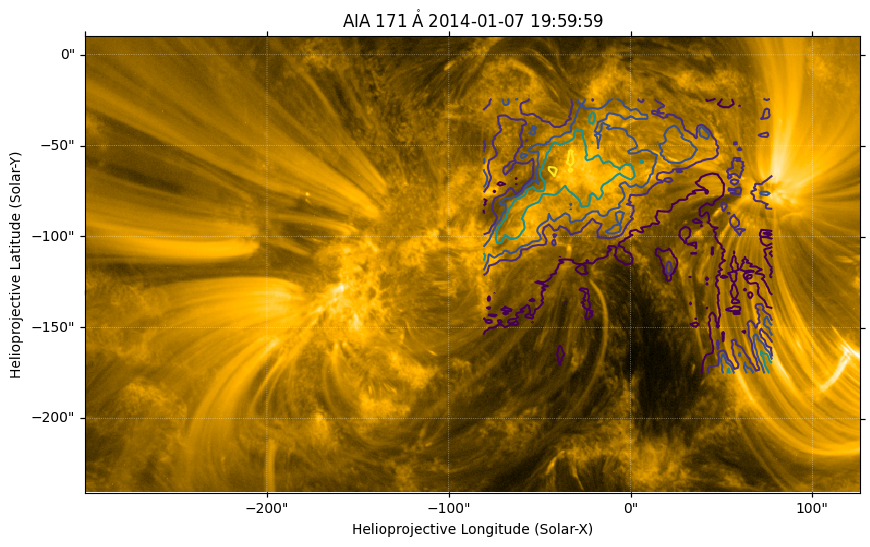

In [412]:
fig = plt.figure(figsize=(10,10))
foo = maps_aia[0].submap(region_1_table[0]['bottom left'],
                         top_right=region_1_table[0]['top right'])
ax = fig.add_subplot(projection=foo)
foo.plot(axes=ax)
m_fe12_1.draw_contours([10,20,30,50,90]*u.percent,axes=ax)

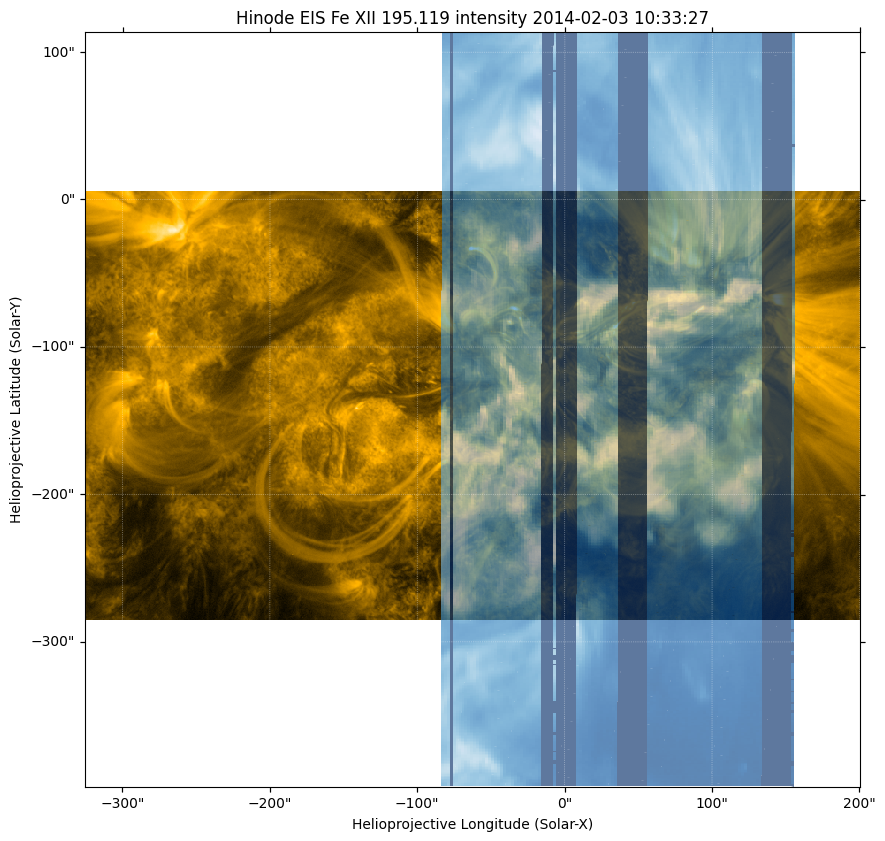

In [408]:
fig = plt.figure(figsize=(10,10))
foo = maps_aia[1].submap(region_1_table[1]['bottom left'],
                         top_right=region_1_table[1]['top right'])
ax = fig.add_subplot(projection=foo)
foo.plot(axes=ax)
m_fe12_2.plot(axes=ax,autoalign=True,alpha=0.65,aspect=1)

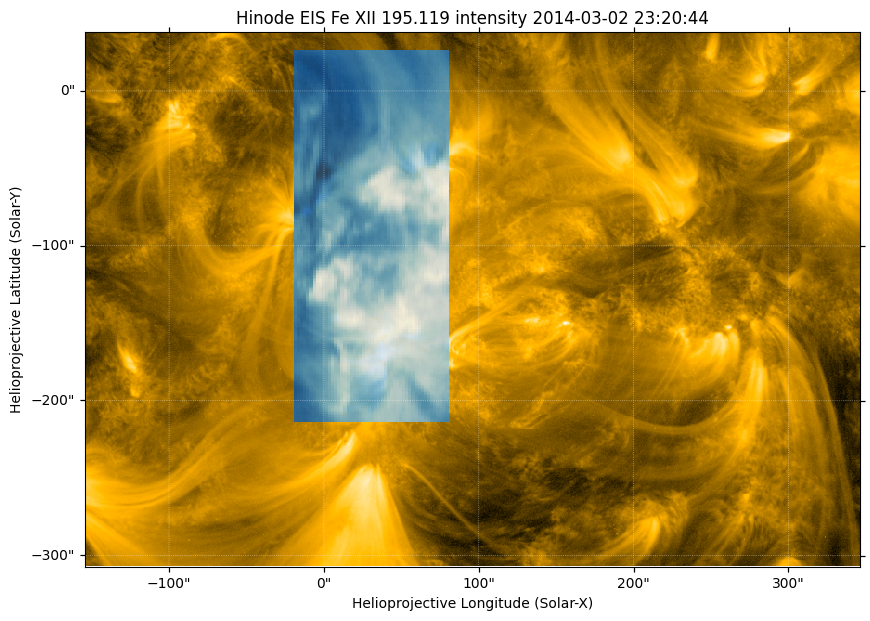

In [404]:
fig = plt.figure(figsize=(10,10))
foo = maps_aia[2].submap(region_1_table[2]['bottom left'],
                         top_right=region_1_table[2]['top right'])
ax = fig.add_subplot(projection=foo)
foo.plot(axes=ax)
m_fe12_3.plot(axes=ax,autoalign=True,alpha=.85,aspect=1.)

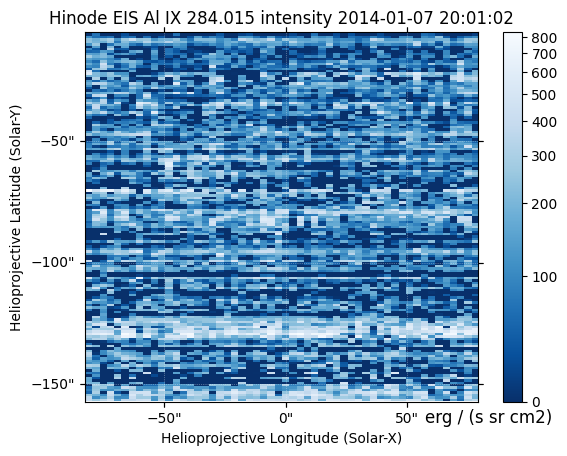

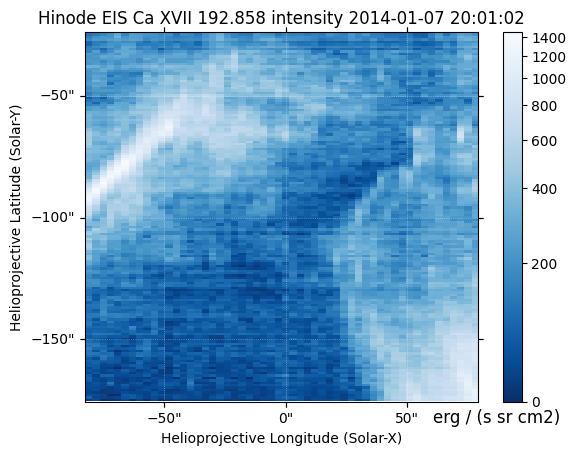

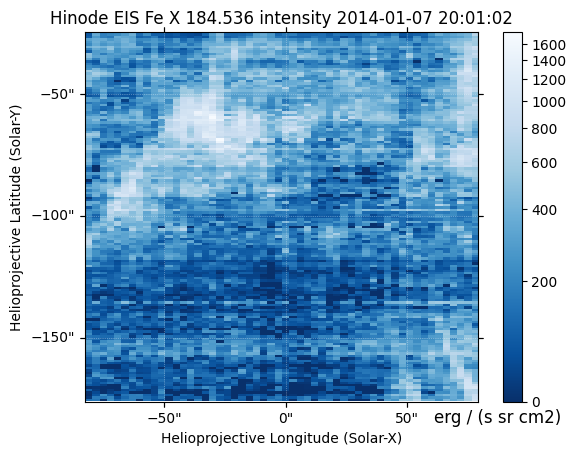

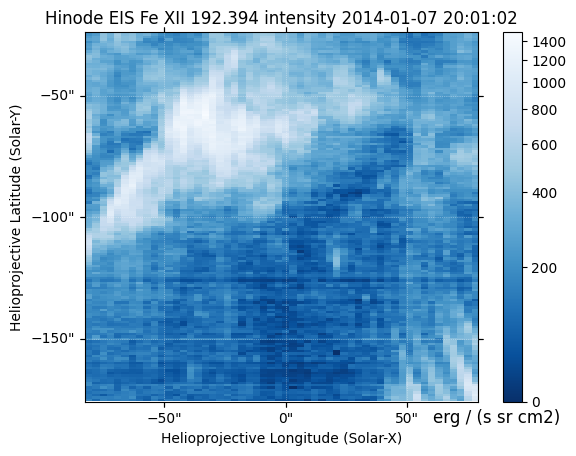

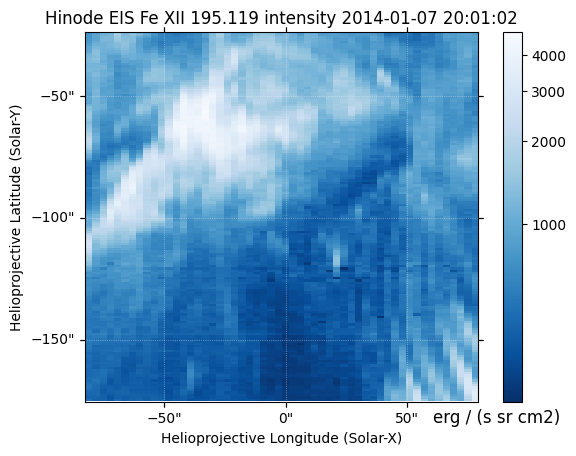

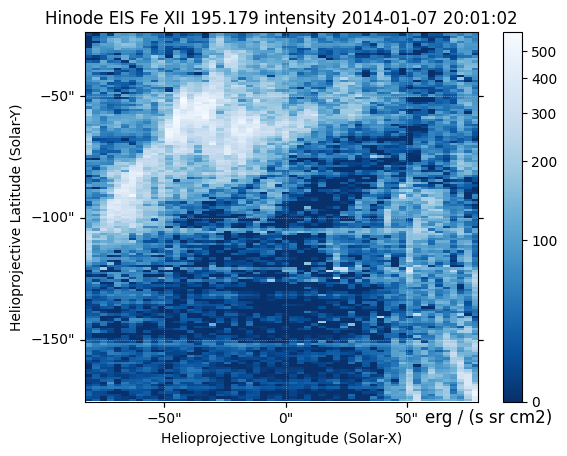

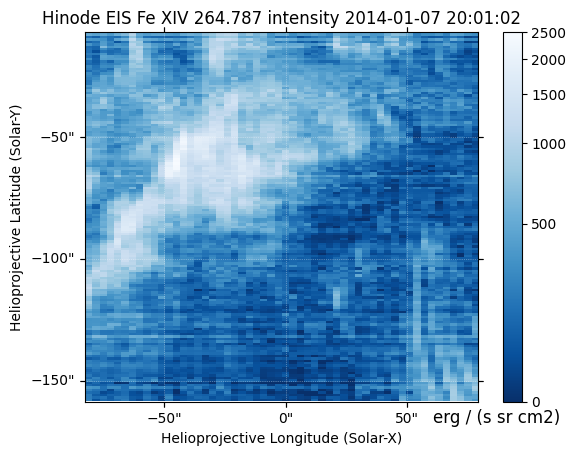

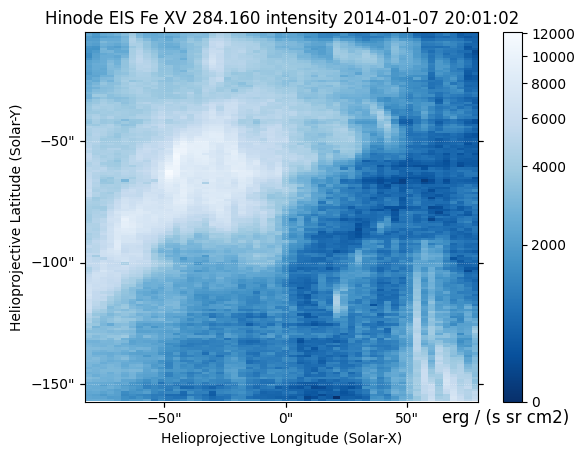

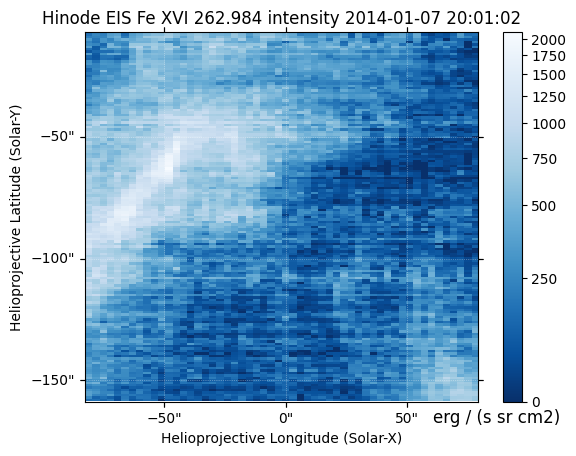

In [361]:
for m in m_eis_1:
    m.peek()

INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


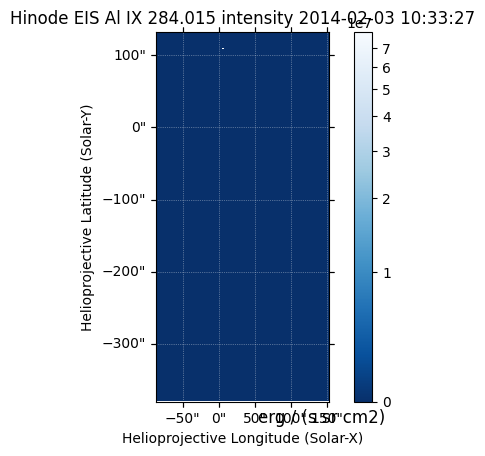

INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


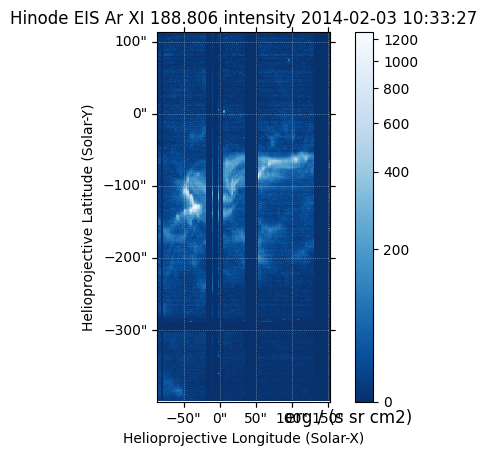

INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


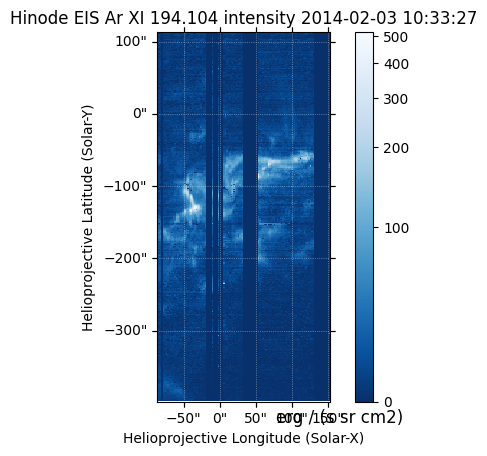

INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


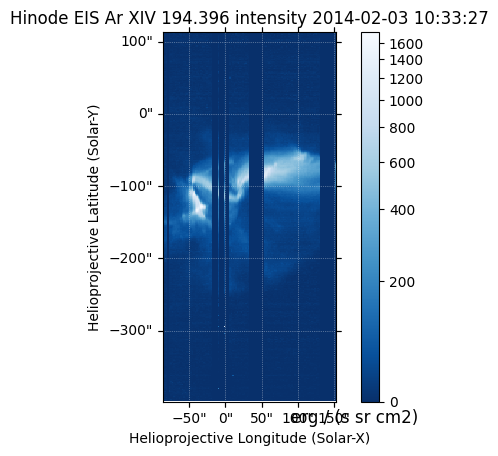

INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


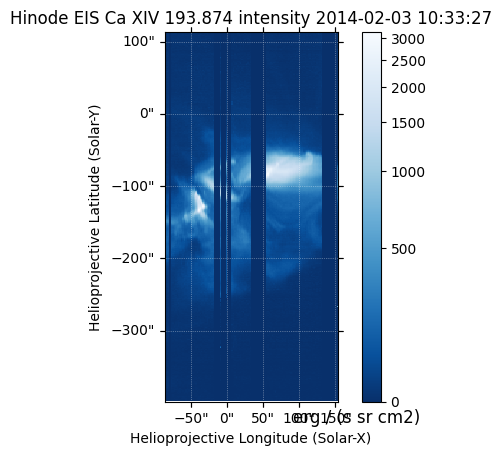

INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


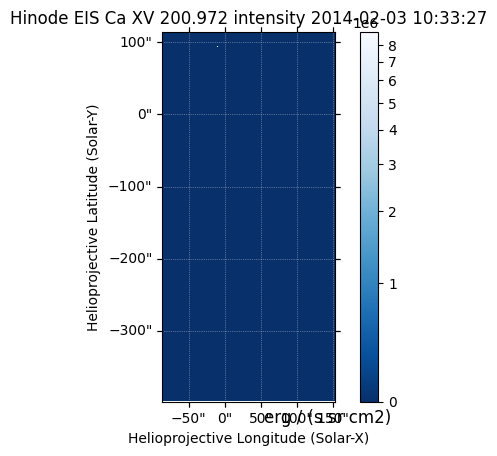

INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


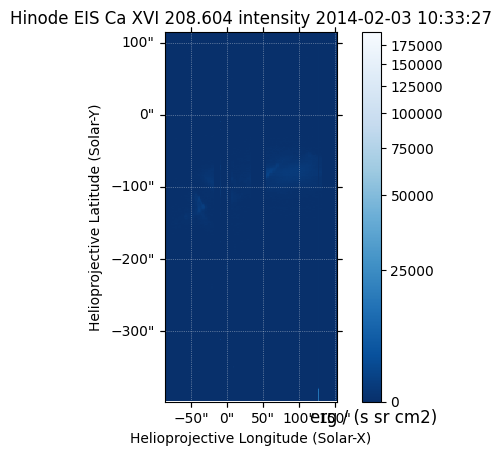

INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


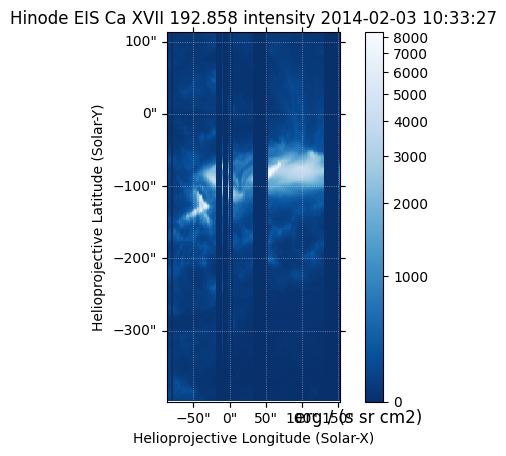

INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


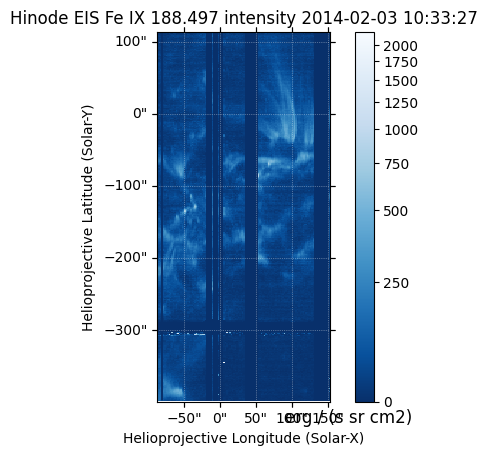

INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


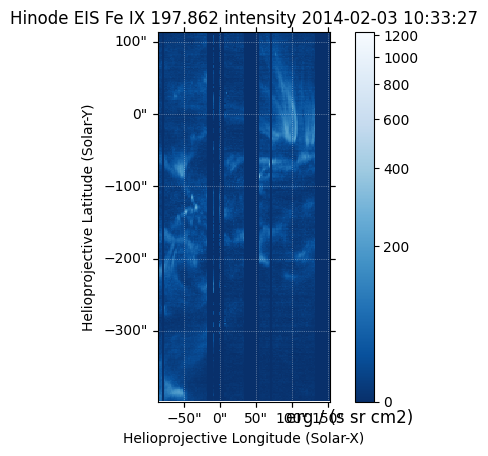

INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


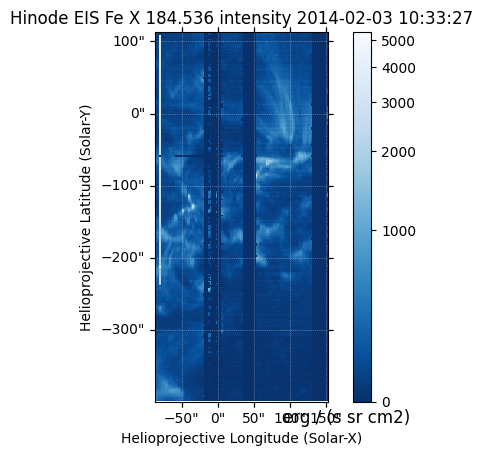

INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


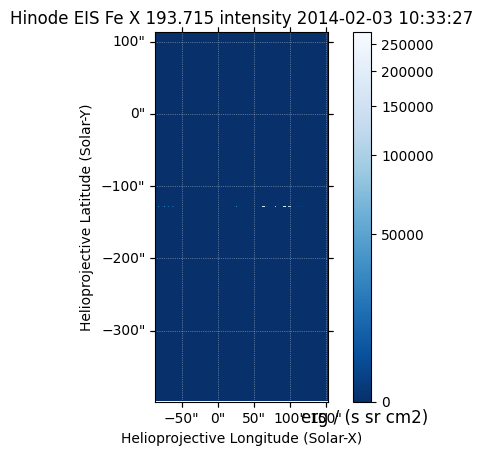

INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


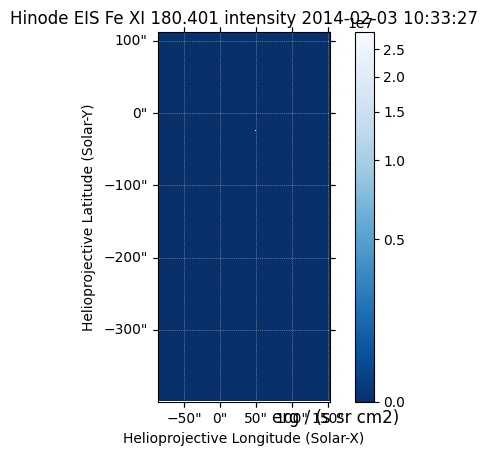

INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


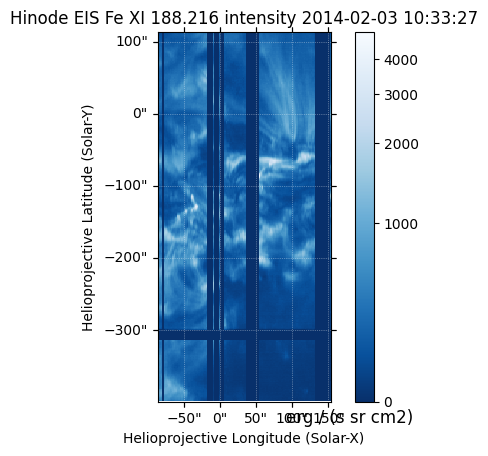

INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


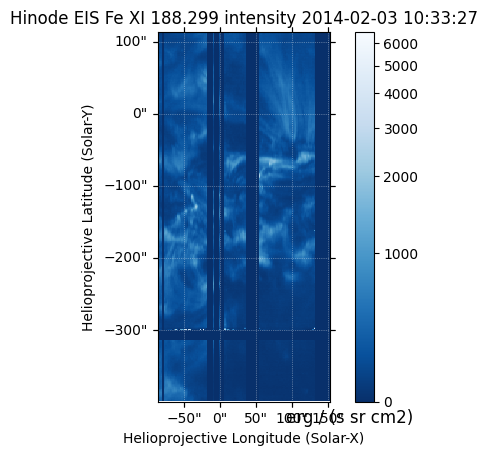

INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


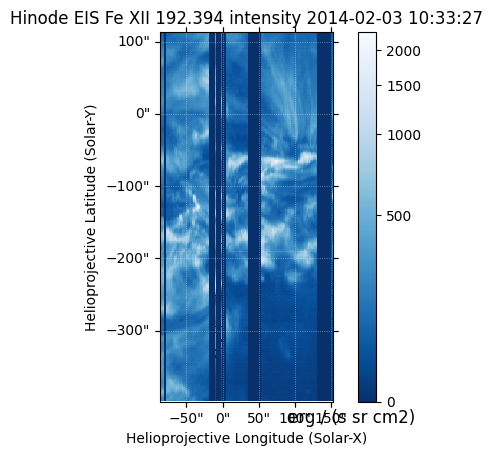

INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


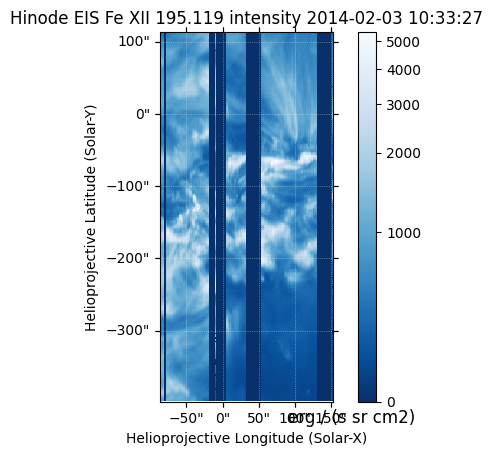

INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


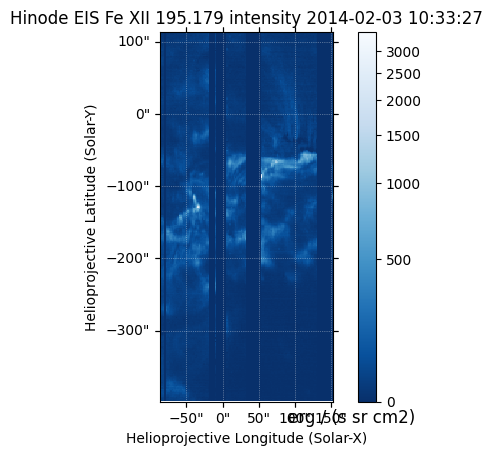

INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


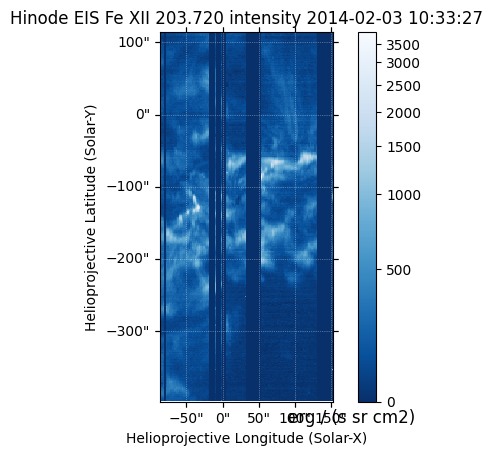

INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


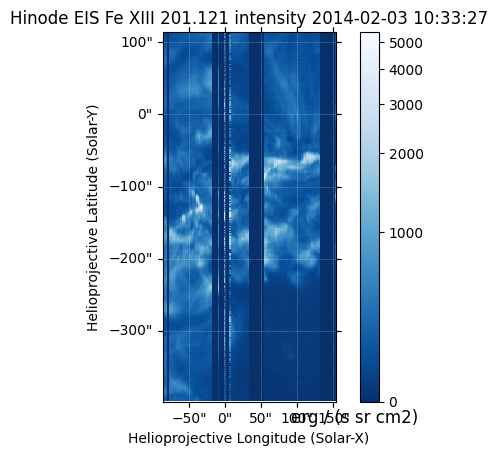

INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


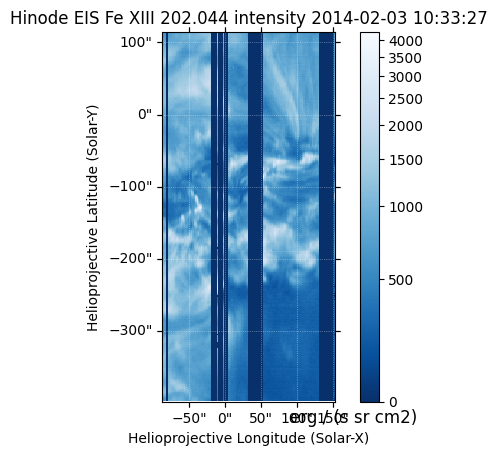

INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


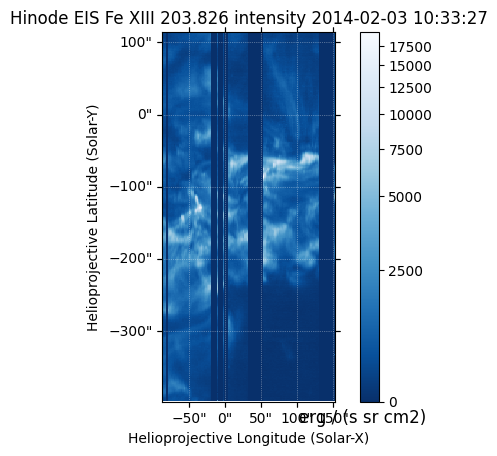

INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


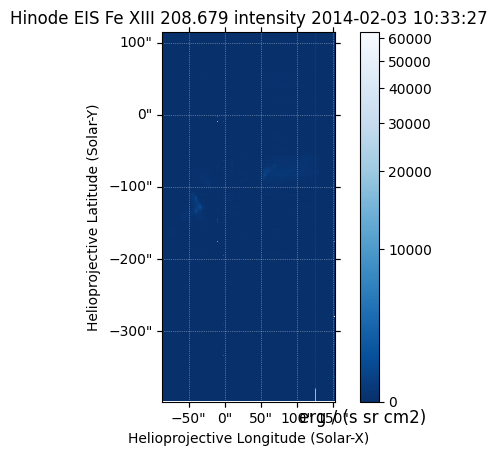

INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


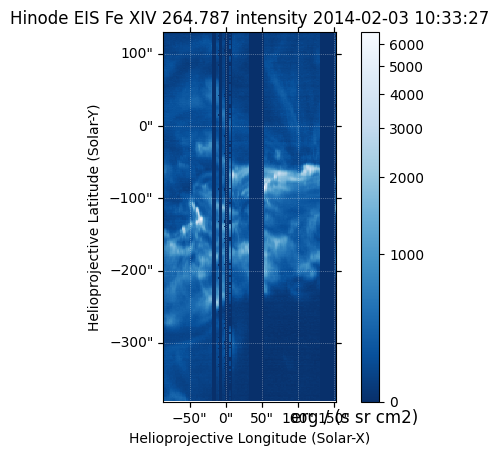

INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


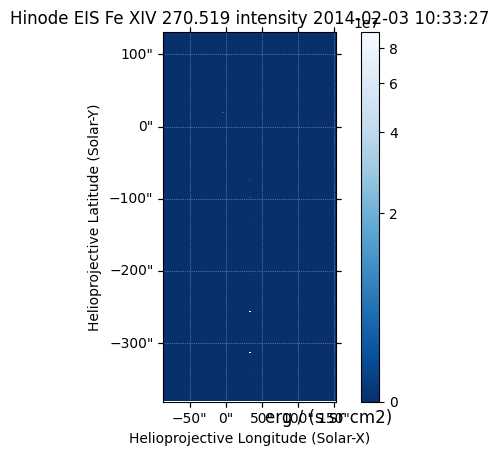

INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


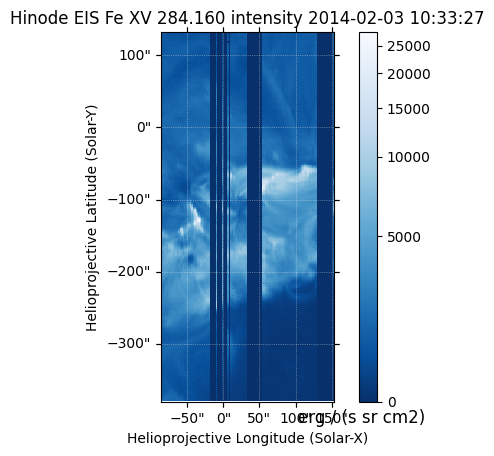

INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


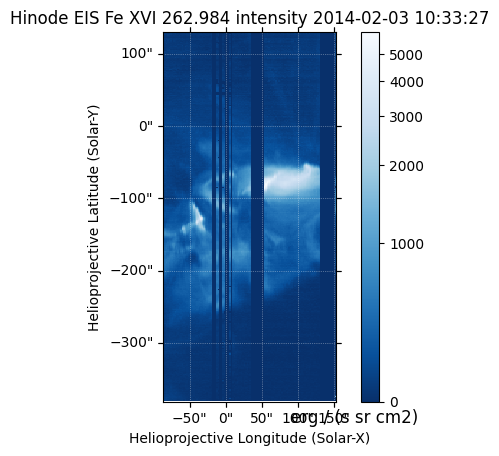

INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


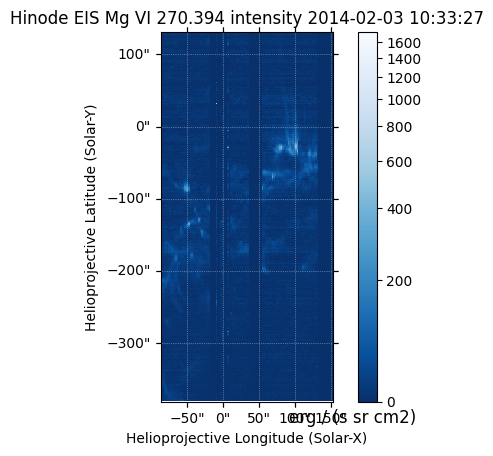

INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


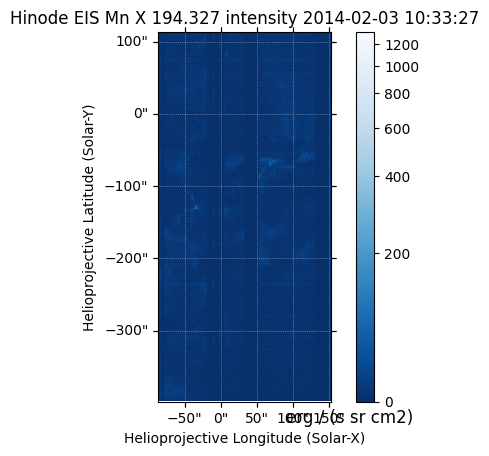

INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


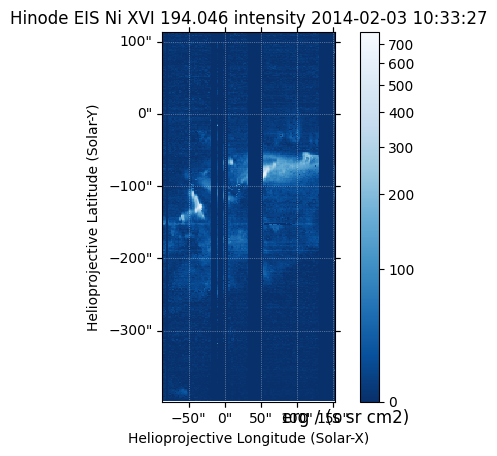

INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


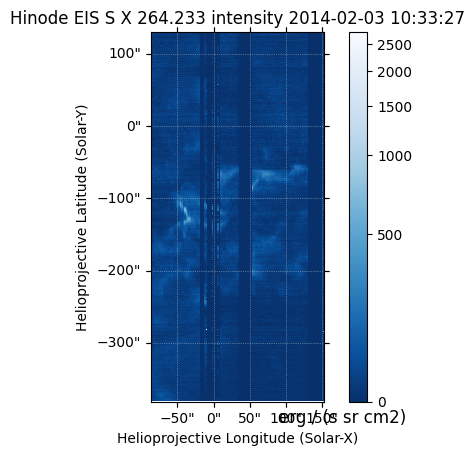

INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


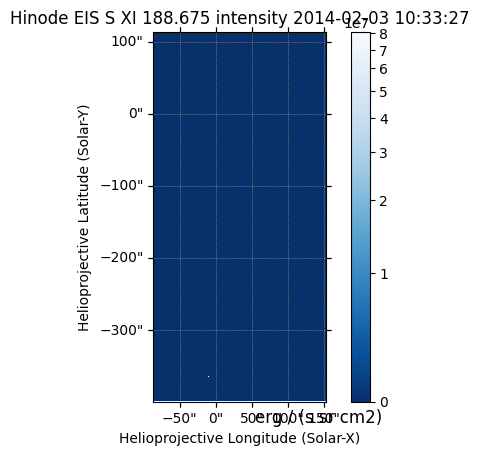

INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


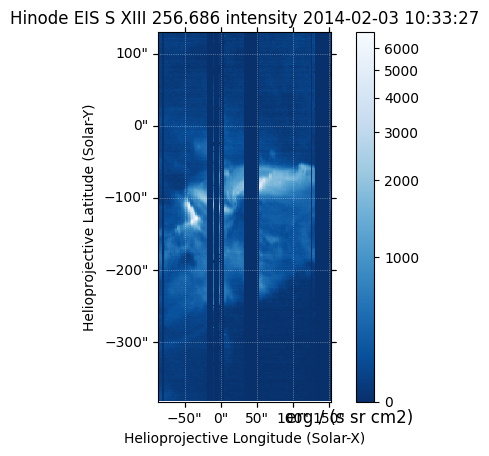

INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


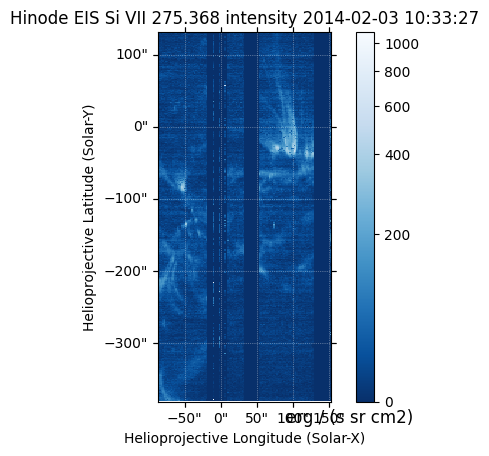

INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


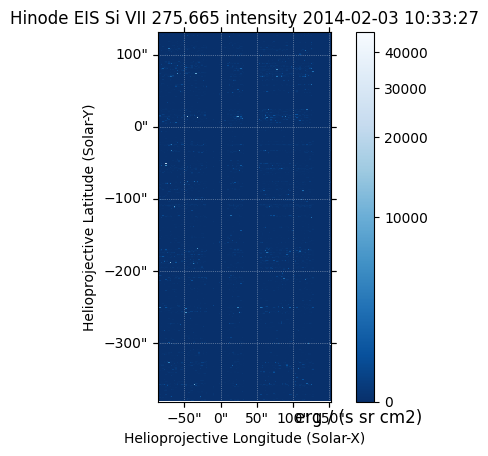

INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


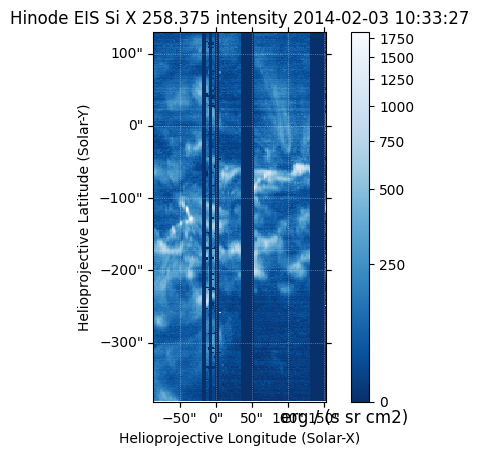

INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


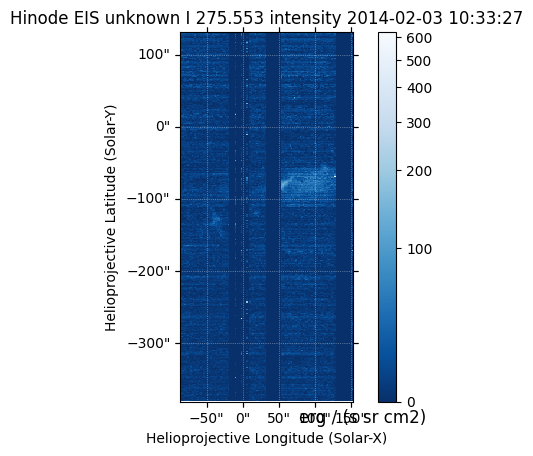

In [362]:
for m in m_eis_2:
    m.peek()

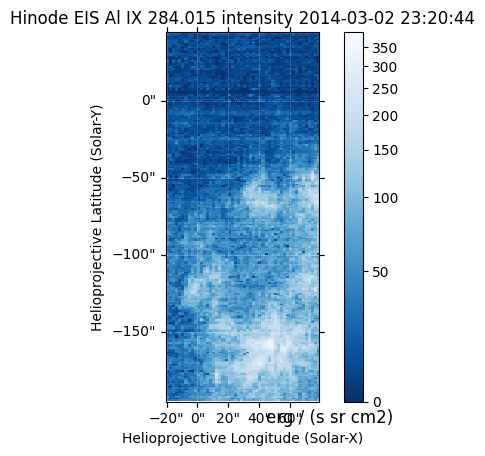

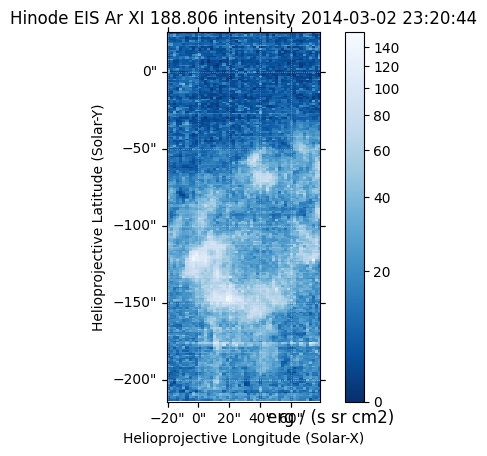

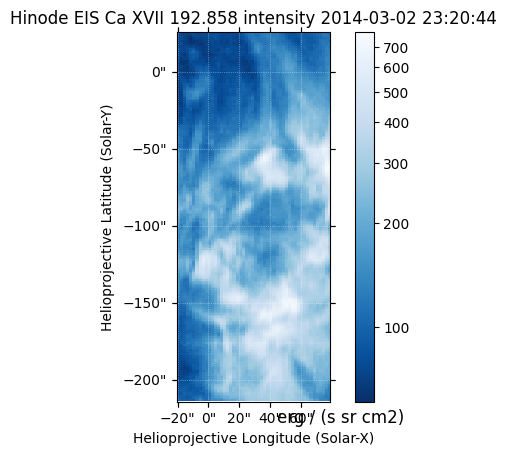

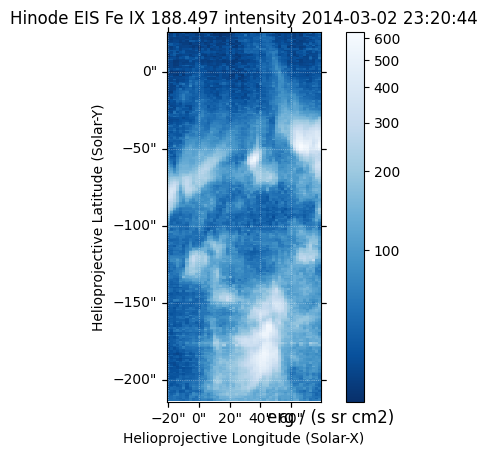

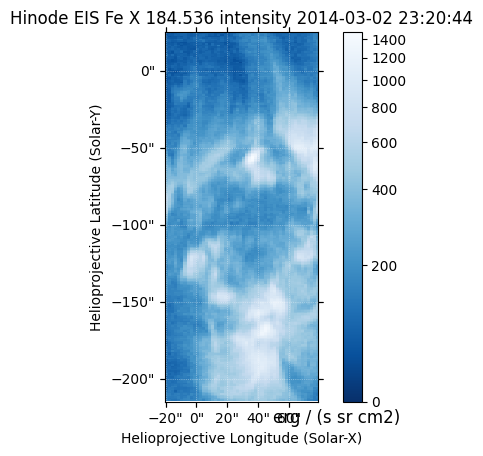

...

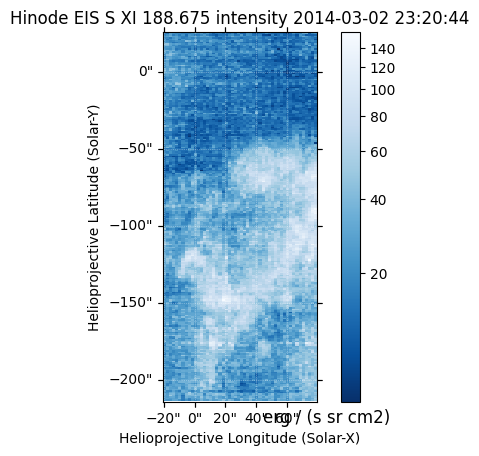

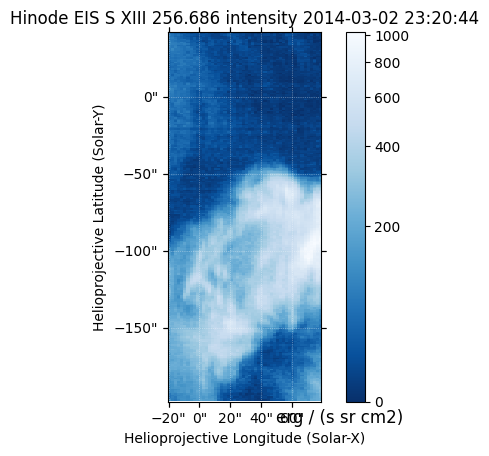

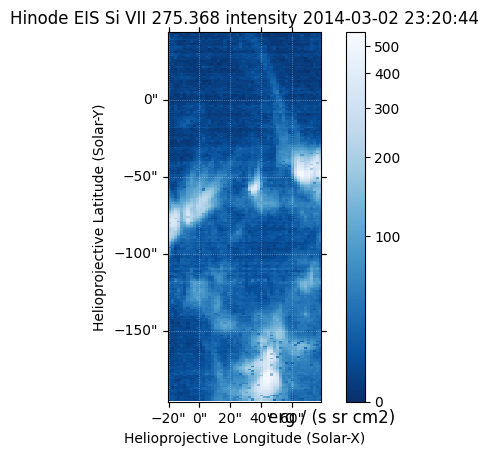

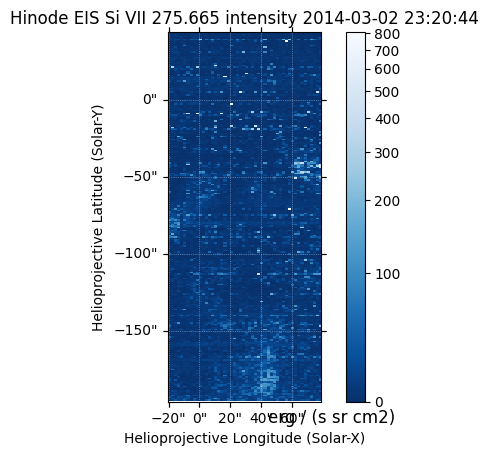

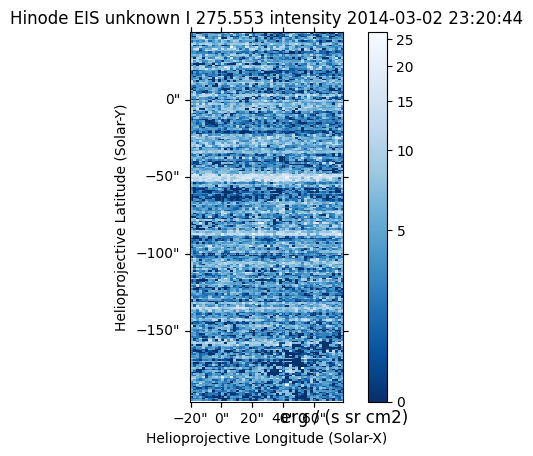

In [363]:
for m in m_eis_3:
    m.peek()

In [417]:
from sunpy.physics.differential_rotation import solar_rotate_coordinate

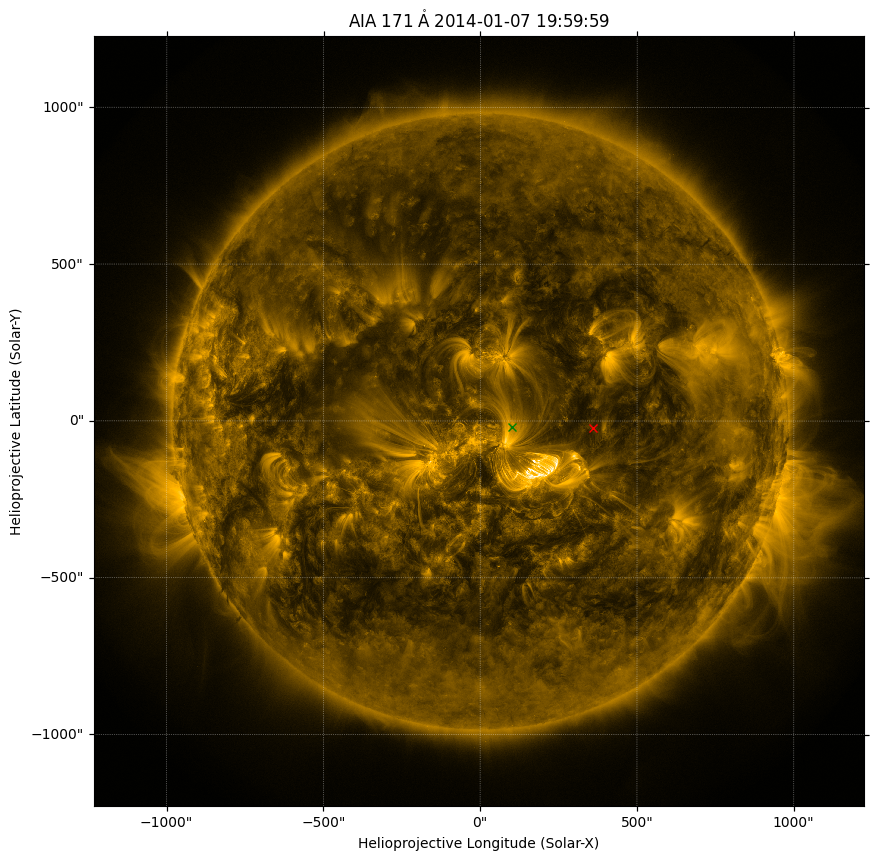

In [419]:
pt0 = SkyCoord(Tx=100*u.arcsec, Ty=-20*u.arcsec, frame=maps_aia[0].coordinate_frame)
pt0_rot = solar_rotate_coordinate(pt0, time=maps_aia[1].date)
fig = plt.figure(figsize=(10,10))
ax = fig.add_subplot(projection=maps_aia[0])
maps_aia[0].plot(axes=ax)
ax.plot_coord(pt0, color='g', marker='x')
ax.plot_coord(pt0_rot, color='r', marker='x')